<a href="https://colab.research.google.com/github/hzl-b/cas-ads/blob/master/Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 1. Project Overview & Objectives

## 2. Imports & Setup
Essential Python libraries are imported, Google Drive is mounted, and the anti-doping dataset is loaded for analysis.

In [1]:
import os
import unicodedata

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler  # Import StandardScaler


In [2]:
from google.colab import drive
drive.mount('/content/drive')

# to attempt to forcibly remount
# drive.mount("/content/drive", force_remount=True)

# Path to your mounted Drive file
file_path = '/content/drive/My Drive/CAS_Final project/Anti-doping_testing_figures_All data.xlsx'

# Load workbook to get all sheet names
xlsx = pd.ExcelFile(file_path, engine='openpyxl')

Mounted at /content/drive


## 3. Data Cleaning & Preprocessing
* Raw data tables are displayed for initial review.
* Each year’s data sheet is processed by standardizing sport names, addressing column inconsistencies, and cleaning numerical entries.
* Columns are merged or removed as necessary to maintain consistency across years.
* Cleaned data from each year is stored in separate DataFrames.
* The list of sports represented in each year’s dataset is summarized.
* A pivot table is created to show the presence of each sport across the different years.




### Data overview
Gives an overview of the cleaned, unified dataset for subsequent analyses.


In [3]:
# Initialize table number
table_number = 1

# First loop (for displaying initial tables)
for sheet in xlsx.sheet_names[:-1]:
    df = pd.read_excel(file_path, sheet_name=sheet, header=1, skipfooter=2, engine='openpyxl')
    print(f"\n=== Table {table_number}: {sheet} ===")
    display(df)
    table_number += 1  # Increment table number


=== Table 1: 2014 ===


,Sports,Discipline,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐ steroids\nS9.,Alcohol\nP1.,Beta‐ Blockers\nP2.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aquatics,Swimming,15.0,1.0,7.0,1.0,14.0,8.0,NaN,NaN,7.0,NaN,NaN,NaN,NaN,53
1,Aquatics,Water Polo,3.0,NaN,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9
2,Aquatics,Aquatics,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4
3,Aquatics,Diving,1.0,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3
4,Archery,NaN,NaN,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210,Taekwondo,University,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
211,Ultimate Fight,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2
212,VA'A,Outrigger (Sprint),NaN,NaN,1.0,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,3
213,Weightlifting,University,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1



=== Table 2: 2015 ===


,Sports,Discipline,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐ steroids\nS9.,Alcohol\nP1.,Beta‐ Blockers\nP2.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aquatics,Swimming,13,‐,4,2,1,6,‐,3,3,‐,‐,‐,‐,32
1,Aquatics,Swimming Sprint 100m or less,‐,‐,4,‐,2,2,‐,‐,1,‐,‐,‐,‐,9
2,Aquatics,Water Polo,2,‐,1,‐,‐,3,‐,1,‐,‐,‐,‐,‐,7
3,Aquatics,Diving,‐,‐,‐,‐,‐,3,‐,‐,1,‐,‐,‐,‐,4
4,Aquatics,Open Water,‐,‐,‐,‐,‐,1,‐,‐,3,‐,‐,‐,‐,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
236,Skiing,University Cross Country,1,‐,‐,‐,‐,‐,‐,‐,‐,‐,‐,‐,‐,1
237,Strongman,‐,‐,‐,‐,‐,1,‐,‐,‐,‐,‐,‐,‐,‐,1
238,VA'A,Outrigger (Sprint),‐,‐,‐,‐,‐,‐,‐,3,‐,‐,‐,‐,‐,3
239,Volleyball,Professional Volleyball,‐,‐,‐,‐,‐,2,‐,‐,‐,‐,‐,‐,‐,2



=== Table 3: 2016 ===


,Sports,Discipline,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐ steroids\nS9.,Alcohol\nP1.,Beta‐ Blockers\nP2.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aquatics,Swimming Sprint 100m or less,1,2,7,14,1,10,‐,‐,2,‐,‐,‐,‐,37
1,Aquatics,Water Polo,19,1,‐,8,‐,3,‐,3,1,‐,‐,‐,‐,35
2,Aquatics,Swimming,9,‐,7,5,10,3,‐,‐,3,‐,‐,‐,‐,37
3,Aquatics,Swimming Middle Distance 200‐400m,4,1,2,8,2,5,‐,‐,1,‐,‐,‐,‐,23
4,Aquatics,Swimming Long Distance 800m or greater,1,1,3,2,‐,2,‐,‐,‐,‐,‐,‐,‐,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
248,Skyrunning,‐,‐,‐,‐,‐,‐,1,‐,‐,‐,‐,‐,‐,‐,1
249,Surfing,Wind Surfing,3,‐,‐,‐,‐,‐,‐,‐,‐,‐,‐,‐,‐,3
250,Traditional Archery,‐,2,‐,‐,1,‐,‐,‐,‐,‐,‐,‐,‐,‐,3
251,Ultimate Fighting,‐,2,‐,‐,1,‐,‐,1,‐,‐,‐,‐,‐,‐,4



=== Table 4: 2017 ===


,Sports,Discipline,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐ steroids\nS9.,Alcohol\nP1.,Beta‐ Blockers\nP2.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aquatics,Swimming Sprint 100m or less,19,‐,6,1,1,7,‐,‐,2,‐,‐,‐,‐,36
1,Aquatics,Swimming Middle Distance 200‐400m,5,‐,1,1,5,2,‐,‐,2,‐,‐,‐,‐,16
2,Aquatics,Open Water,3,1,‐,‐,1,4,‐,‐,‐,‐,‐,‐,‐,9
3,Aquatics,Water Polo,2,‐,‐,2,‐,1,‐,1,‐,‐,‐,‐,‐,6
4,Aquatics,Diving,2,‐,‐,‐,‐,3,‐,‐,‐,‐,‐,‐,‐,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
303,Traditional Archery,Traditional Archery,‐,‐,‐,‐,2,‐,‐,‐,‐,‐,‐,‐,‐,2
304,Ultimate Fighting,Ultimate Fighting,‐,‐,‐,1,1,1,‐,‐,‐,‐,‐,‐,‐,3
305,VA'A,Outrigger (Sprint),1,‐,‐,‐,‐,‐,‐,‐,2,‐,‐,‐,‐,3
306,Volleyball,Military Volleyball,‐,‐,‐,‐,‐,‐,‐,‐,2,‐,‐,‐,‐,2



=== Table 5: 2018 ===


,Sports,Discipline,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐ steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aquatics,Swimming Sprint 100m or less,8,‐,6,4,‐,14,‐,1,2,‐,‐,‐,35
1,Aquatics,Swimming Middle Distance 200‐400m,11,1,1,2,2,6,‐,‐,5,‐,‐,‐,28
2,Aquatics,Water Polo,2,‐,‐,‐,3,6,‐,‐,‐,‐,‐,‐,11
3,Aquatics,Swimming Long Distance 800m or greater,2,‐,2,1,‐,‐,‐,‐,‐,‐,‐,‐,5
4,Aquatics,Open Water,‐,‐,1,1,1,‐,‐,‐,‐,‐,‐,‐,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
272,VA'A,Outrigger (Sprint),1,‐,‐,‐,‐,‐,‐,1,‐,‐,‐,‐,2
273,Volleyball,Professional Volleyball,‐,‐,‐,‐,‐,‐,‐,‐,2,‐,‐,‐,2
274,Volleyball,University Volleyball,1,‐,‐,‐,‐,‐,‐,‐,‐,‐,‐,‐,1
275,Wrestling,University,1,‐,‐,‐,‐,1,‐,‐,‐,‐,‐,‐,2



=== Table 6: 2019 ===


,Sports,Discipline,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐ steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aquatics,Swimming Sprint 100m or less,9,-,4,1,4,16,-,2,-,-,-,-,36
1,Aquatics,Swimming Middle Distance 200-400m,10,-,2,-,3,7,-,-,2,-,-,-,24
2,Aquatics,Swimming Long Distance 800m or greater,3,1,1,-,-,4,-,-,-,-,-,-,9
3,Aquatics,Water Polo,-,-,1,-,1,2,-,1,1,-,-,-,6
4,Aquatics,Artistic Swimming,-,-,-,-,3,-,-,-,-,-,-,-,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
254,Traditional Archery,-,-,-,-,-,-,-,-,-,-,1,-,-,1
255,VA'A,Outrigger (Sprint),-,-,-,-,-,-,-,1,-,-,-,-,1
256,Volleyball,Professional Volleyball,-,-,-,-,-,-,-,-,4,-,-,-,4
257,Volleyball,College,-,-,-,-,-,1,-,-,-,-,-,-,1



=== Table 7: 2020 ===


,Sports,Discipline,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐ steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aquatics,Swimming Sprint 100m or less,2,-,1,1,-,9,-,-,2,-,-,-,15
1,Aquatics,Swimming Middle Distance 200-400m,1,-,2,1,-,5,-,-,-,-,-,-,9
2,Aquatics,Water Polo,-,-,-,-,-,1,-,2,-,-,-,-,3
3,Aquatics,Diving,-,-,-,-,-,1,-,-,-,-,-,-,1
4,Aquatics,Swimming Long Distance 800m or greater,-,-,-,-,-,1,-,-,-,-,-,-,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
164,Gaelic Games,Football,-,-,-,1,-,-,-,-,-,-,-,-,1
165,Golf,Professional Golf (R),-,-,-,-,3,-,-,-,-,-,-,-,3
166,Kabaddi,Kabaddi (R),12,-,-,1,-,3,-,-,-,-,-,-,16
167,Mixed Martial Arts,Mixed Martial Arts (R),64,1,2,9,10,3,-,4,-,-,-,-,93



=== Table 8: 2021 ===


,Sports,Discipline,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aquatics,Swimming Sprint 100m or less,8,-,3,11,-,17,-,1,-,-,-,-,40
1,Aquatics,Swimming Middle Distance 200-400m,2,2,5,14,3,6,-,-,-,-,-,-,32
2,Aquatics,Swimming Long Distance 800m or greater,1,-,-,6,-,1,-,-,2,-,-,-,10
3,Aquatics,Water Polo,-,-,-,2,-,1,-,-,-,-,-,-,3
4,Aquatics,Open Water,-,-,1,-,1,1,-,-,-,-,-,-,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
193,Ice Hockey,University,-,-,-,-,-,1,-,-,-,-,-,-,1
194,Rugby,University Sevens,-,-,-,-,-,3,-,-,-,-,-,-,3
195,Athletics,Ultra Trail,-,-,-,-,-,1,-,-,4,-,-,-,5
196,Athletics,Short Trail,-,-,-,-,-,-,-,1,-,-,-,-,1



=== Table 9: 2022 ===


,Sports,Discipline,Anabolic Agents\nS1.1,Other Anabolic Agents\nS1.2,"Peptide Hormones, Growth Factors, Related Substances and Mimetics\nS2.",Beta-2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aquatics,Swimming Sprint 100m or less,12,4,-,1,4,2,9,-,-,-,-,-,-,32
1,Aquatics,Swimming Middle Distance 200-400m,-,-,-,1,5,6,7,-,-,-,-,-,-,19
2,Aquatics,Water Polo,-,-,-,-,1,2,4,-,-,-,-,-,-,7
3,Aquatics,Diving,-,-,-,-,-,1,2,-,1,-,-,-,-,4
4,Aquatics,Swimming Long Distance 800m or greater,1,-,-,2,-,-,1,-,-,-,-,-,-,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
222,Athletics,University Middle Distance 800-1500m,-,-,-,-,-,2,1,-,-,-,-,-,-,3
223,Athletics,University Throws,-,-,-,-,-,-,1,-,-,-,-,-,-,1
224,Ice Hockey,University,-,-,-,-,-,-,2,-,-,-,-,-,-,2
225,Rugby Union,University Fifteens,-,-,-,-,-,-,2,-,-,-,-,-,-,2


In [4]:
# Dictionary to store each sheet's processed DataFrame
tables = {}

# Loop through every sheet except the last one
# Second loop (for processing and displaying processed tables)
tables = {}
for sheet in xlsx.sheet_names[:-1]:

    # --- A) Read title & data fresh each time ---
    title = (
        pd.read_excel(
            file_path,
            sheet_name=sheet,
            header=None,
            nrows=1,
            engine='openpyxl'
        )
        .iloc[0, 0]
    )
    df = pd.read_excel(
        file_path,
        sheet_name=sheet,
        header=1,
        skipfooter=2,
        engine='openpyxl'
    )

    # --- B) Identify your "sport" column ---
    sport_col = df.columns[0]

    # --- C) If it was a stray index, drop it ---
    if sport_col is None or str(sport_col).isdigit() or str(sport_col).startswith('Unnamed'):
        df = df.iloc[:, 1:]
        sport_col = df.columns[0]

    # --- Custom adjustments by sheet ---
    if str(sheet) == '2022':
        # Merge columns 2 and 3 into new column at position 2
        col_a = df.columns[2]
        col_b = df.columns[3]
        new_col = 'Anabolic Agents\nS1.'
        # Convert to numeric then sum
        a_vals = pd.to_numeric(df[col_a].replace('-', pd.NA), errors='coerce').fillna(0).astype(int)
        b_vals = pd.to_numeric(df[col_b].replace('-', pd.NA), errors='coerce').fillna(0).astype(int)
        df[new_col] = a_vals + b_vals
        # Drop original columns
        df = df.drop([col_a, col_b], axis=1)
        # Reorder so new column is second
        cols = list(df.columns)
        cols.insert(2, cols.pop(cols.index(new_col)))
        df = df[cols]
        # Rename the 4th column to S2 title
        if len(df.columns) >= 4:
            df.rename(columns={df.columns[3]: 'Peptide Hormones, Growth Factors and Related Substances\nS2.'}, inplace=True)

    # Remove 12th column for older sheets
    if str(sheet) in ['2014', '2015', '2016', '2017']:
        if len(df.columns) >= 12:
            df = df.drop(df.columns[11], axis=1)

    # --- D) Drop the 2nd column entirely ---
    df = df.drop(df.columns[1], axis=1)

    # --- E) Coerce all remaining data columns to ints ---
    data_cols = df.columns.drop(sport_col)
    df[data_cols] = (
        df[data_cols]
          .replace('-', pd.NA)               # dashes → NA
          .apply(pd.to_numeric, errors='coerce')
          .fillna(0)
          .astype(int)
    )

    # --- F) Normalize the sport names so grouping will catch typos/spaces ---
    df[sport_col] = (
        df[sport_col]
          .astype(str)
          .apply(lambda x: unicodedata.normalize('NFKC', x))  # fix weird spaces
          .str.strip()                                        # trim ends
          .str.replace(r'\s+', ' ', regex=True)               # collapse multi-spaces
          .str.title()                                        # unify casing
          .str.replace('‐', '-', regex=True)                  # Replace special hyphen with regular hyphen
    )

    # --- G) Group on sport_col and sum only the numeric columns back in ---
    df = (
        df
        .groupby(sport_col, as_index=False)[list(data_cols)]
        .sum()
    )

    # --- Rename columns (2 to 13) ---
    desired_columns = [
        "Anabolic Agents\nS1.",
        "Peptide Hormones, Growth Factors and Related Substances\nS2.",
        "Beta‐2 Agonists\nS3.",
        "Hormone and Metabolic Modulators\nS4.",
        "Diuretics and Other Masking Agents\nS5.",
        "Stimulants\nS6.",
        "Narcotics\nS7.",
        "Cannabinoids\nS8.",
        "Glucocortico‐steroids\nS9.",
        "Beta-Blockers\nP1.",
        "Enhancement of Oxygen Transfer\nM1.",
        "Chemical and Physical Manipulation\nM2."
    ]

    # Get the current column names (excluding the first column which is the sport)
    current_columns = df.columns[1:]

    # Rename the columns, handling potential length differences
    num_cols_to_rename = min(len(current_columns), len(desired_columns))
    rename_dict = {current_columns[i]: desired_columns[i] for i in range(num_cols_to_rename)}
    df = df.rename(columns=rename_dict)

    # Store processed DataFrame
    tables[sheet] = df

# --- H) Show title + first/last 5 rows ---
    print(f"\n=== Table {table_number}: {title} ===")
    display(df)
    table_number += 1  # Increment table number

# Now each sheet's DataFrame is accessible via tables['2014'], tables['2022'], etc.


=== Table 10: 2014 - Total AAFs* per Drug Class as Reported in Sports ===


,Sports,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,American Football,7,1,2,0,2,3,3,2,2,0,0,0,22
1,Aquatics,21,1,7,1,18,23,0,0,8,0,0,0,79
2,Archery,1,0,0,0,6,5,0,0,0,2,0,0,14
3,Arm Wrestling,26,0,0,0,3,4,0,0,0,0,0,0,33
4,Athletics,171,26,15,9,24,42,4,2,28,0,0,1,322
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,Va'A,0,0,1,0,0,0,1,1,0,0,0,0,3
95,Volleyball,5,0,2,0,1,5,0,2,0,0,0,0,15
96,Weightlifting,152,1,3,10,32,15,0,2,8,0,0,0,223
97,Wrestling,44,0,2,3,18,5,0,2,1,0,0,0,75



=== Table 11: 2015 - Total AAFs* per Drug Class as Reported in Sports ===


,Sports,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Air Sports,1,0,0,0,3,0,0,0,0,0,0,0,4
1,American Football,19,0,5,0,1,6,0,3,0,0,0,0,34
2,Aquatics,17,0,10,3,6,16,0,4,8,0,0,0,64
3,Archery,4,0,0,1,2,3,0,0,0,2,0,0,12
4,Arm Wrestling,25,1,0,1,3,1,0,0,0,0,0,0,31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,Volleyball,11,0,0,0,2,11,0,4,2,0,0,0,30
92,Waterskiing,1,0,0,0,0,1,0,0,0,0,0,0,2
93,Weightlifting,262,8,0,15,18,23,2,2,4,0,0,0,334
94,Wrestling,31,2,0,1,17,14,0,1,5,0,0,0,71



=== Table 12: 2016 - Total AAFs* per Drug Class as Reported in Sports ===


,Sports,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Air Sports,0,0,0,0,0,0,0,1,0,0,0,0,1
1,American Football,39,1,6,1,3,28,0,3,0,0,0,0,81
2,Aquatics,40,5,21,38,14,33,0,4,11,0,0,0,166
3,Archery,2,0,0,0,8,4,0,0,0,5,0,0,19
4,Arm Wrestling,1,0,0,0,1,0,0,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102,Volleyball,21,0,0,5,3,3,0,1,2,0,0,0,35
103,Waterskiing,0,0,0,0,0,0,0,1,0,0,0,0,1
104,Weightlifting,111,5,6,42,11,20,0,2,4,0,0,0,201
105,Wrestling,56,1,2,68,21,7,1,2,0,0,0,0,158



=== Table 13: 2017 - Total AAFs* per Drug Class as Reported in Sports ===


,Sports,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Aikido,0,0,0,0,0,0,0,0,0,0,0,0,0
1,Air Sports,0,0,1,0,1,0,0,0,0,0,0,0,2
2,American Football,15,1,2,5,1,16,0,7,1,0,0,0,48
3,Aquatics,36,1,8,6,9,22,1,1,4,0,0,0,88
4,Archery,0,0,0,0,2,1,0,0,0,6,0,0,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127,Volleyball,11,0,3,1,3,5,0,1,4,0,0,0,28
128,Waterskiing,3,0,0,0,0,1,0,0,0,0,0,0,4
129,Weightlifting,129,3,8,12,25,23,1,2,3,0,0,0,206
130,Wrestling,46,2,4,13,18,15,0,6,3,0,0,0,107



=== Table 14: 2018 - Total AAFs* per Drug Class as Reported in Sports ===


,Sports,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Air Sports,1,0,0,0,1,2,0,0,1,0,0,0,5
1,American Football,34,0,5,2,0,14,0,10,5,0,0,0,70
2,Aquatics,24,1,10,8,9,26,0,1,7,0,0,0,86
3,Archery,1,0,0,0,13,0,0,1,0,3,0,0,18
4,Arm Wrestling,29,0,0,1,3,5,0,0,0,0,0,0,38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110,Volleyball,17,1,3,2,0,10,0,5,7,0,0,0,45
111,Waterskiing,1,0,0,0,0,2,0,0,2,0,0,0,5
112,Weightlifting,143,4,4,18,14,34,0,5,12,0,0,0,234
113,Wrestling,55,0,1,11,17,13,0,1,0,0,0,0,98



=== Table 15: 2019 - Total AAFs* per Drug Class as Reported in Sports ===


,Sports,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,Air Sports,31,2,1,3,3,0,0,0,0,0,0,0,40
1,American Football,12,0,2,3,0,14,0,10,1,0,0,0,42
2,Aquatics,23,2,9,2,12,31,0,3,3,0,0,0,85
3,Archery,0,0,1,0,2,0,1,0,1,3,0,0,8
4,Arm Wrestling,14,0,0,4,8,4,0,1,0,0,0,0,31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110,Volleyball,14,0,0,0,4,6,1,3,7,0,0,0,35
111,Waterskiing,1,0,0,0,5,0,0,1,0,0,0,0,7
112,Weightlifting,142,7,3,31,16,41,2,5,10,0,0,0,257
113,Wrestling,44,1,3,16,17,24,3,6,1,0,0,0,115



=== Table 16: 2020 - Total AAFs* per Drug Class as Reported in Sports ===


,Sports,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,American Football,2,0,3,0,1,1,1,1,0,0,0,0,9
1,Aquatics,3,0,4,2,0,17,0,2,2,0,0,0,30
2,Archery,1,0,0,0,1,3,0,0,0,1,0,0,6
3,Arm Wrestling,2,0,0,0,0,0,0,0,0,0,0,0,2
4,Athletics,58,7,7,8,12,31,0,2,8,0,0,0,133
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70,Underwater Sports,0,0,0,0,3,0,0,0,0,8,0,0,11
71,Volleyball,5,0,1,1,0,10,1,3,1,0,0,0,22
72,Weightlifting,81,2,6,10,7,15,0,2,0,0,0,0,123
73,Wrestling,40,2,2,8,8,6,0,3,1,0,0,0,70



=== Table 17: 2021 - Total AAFs* per Drug Class as Reported in Sports ===


,Sports,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,American Football,6,0,0,0,0,7,0,3,1,0,0,0,17
1,Aquatics,11,2,9,33,6,26,0,1,2,0,0,0,90
2,Archery,5,0,0,0,10,2,0,0,1,5,0,0,23
3,Arm Wrestling,20,0,0,1,4,1,0,1,0,0,0,0,27
4,Athletics,97,31,5,23,13,23,2,6,20,0,4,0,224
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86,Volleyball,7,0,0,4,3,2,0,4,2,0,0,0,22
87,Waterskiing,0,0,0,0,1,0,0,1,0,0,0,0,2
88,Weightlifting,77,5,2,16,13,14,1,3,5,0,0,0,136
89,Wrestling,42,4,2,10,8,9,1,2,2,0,0,0,80



=== Table 18: 2022 - Total AAFs* per Drug Class as Reported in Sports ===


,Sports,Anabolic Agents\nS1.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Beta‐2 Agonists\nS3.,Hormone and Metabolic Modulators\nS4.,Diuretics and Other Masking Agents\nS5.,Stimulants\nS6.,Narcotics\nS7.,Cannabinoids\nS8.,Glucocortico‐steroids\nS9.,Beta-Blockers\nP1.,Enhancement of Oxygen Transfer\nM1.,Chemical and Physical Manipulation\nM2.,Total
0,American Football,10,1,1,1,2,8,0,6,0,0,0,0,29
1,Aquatics,19,0,4,11,16,25,0,1,0,0,0,0,76
2,Archery,0,0,2,1,6,1,0,2,0,3,0,0,15
3,Arm Wrestling,29,0,0,5,7,3,1,0,0,0,0,0,45
4,Athletics,134,50,12,33,18,42,1,2,13,0,0,0,305
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,Volleyball,3,0,0,2,3,2,0,4,1,0,0,0,15
97,Waterskiing,0,0,1,0,0,0,0,1,0,0,0,0,2
98,Weightlifting,136,6,6,18,14,28,0,6,3,0,0,0,217
99,Wrestling,53,4,0,10,10,19,1,4,1,0,0,0,102


### Pivot Table: Sports Presence Across Years

In [5]:
# Container for each sheet's sports
sports_by_sheet = {}

# Loop through all but the last sheet
for sheet in xlsx.sheet_names[:-1]:
    # Read the sheet
    df = pd.read_excel(file_path, sheet_name=sheet, header=1, skipfooter=2, engine='openpyxl')

    # Normalize the sport column
    sport_col = df.columns[0]
    sports = (
        df[sport_col]
        .astype(str)
        .apply(lambda x: unicodedata.normalize('NFKC', x))
        .str.strip()
        .str.replace(r'\s+', ' ', regex=True)
        .str.title()
        .str.replace('‐', '-', regex=True)  # Replace special hyphen
        .str.replace(r'\(R\)', '', regex=True)
        .apply(lambda x: x.replace('Jiu-Jitsu', 'Brazilian Jiu-Jitsu'))
        .apply(lambda x: x.replace('BrazilianJiu-Jitsu', 'Brazilian Jiu-Jitsu'))
        .apply(lambda x: x.replace('Brazilian Brazilian Jiu-Jitsu', 'Brazilian Jiu-Jitsu'))
        .apply(lambda x: x.replace('Ski-Mountaineering', 'Ski Mountaineering') if sheet == '2014' else x)
        .unique()
        .tolist()
    )
    # Store the sports for the current sheet
    sports_by_sheet[sheet] = sports

# Create a list to store the data for the DataFrame
table_data = []

# Loop through each sheet's sports and total
for sheet, sports in sports_by_sheet.items():
    for sport in sorted(sports):
        table_data.append([sheet, sport])

# Create a Pandas DataFrame from the table data
df_sports = pd.DataFrame(table_data, columns=['Year', 'Sport'])

# Pivot the DataFrame to have years as columns
df_sports_pivot = df_sports.pivot(index='Sport', columns='Year', values='Sport')

# Replace NaN values with empty strings (instead of False)
df_sports_pivot = df_sports_pivot.fillna('')  # Replace NaNs with the name of the sport

# --- Remove the first column (sport names) ---
df_sports_pivot = df_sports_pivot.reset_index(drop=True)

# --- Calculate and add total per year (treating empty as 0) ---
df_sports_pivot.loc['Total'] = (df_sports_pivot != '').sum()  # Count non-empty cells

# --- Naming the table with numbering ---
print(f"\n=== Table {table_number}: Sports analyzed for doping from 2014 to 2022 ===")
table_number += 1  # Increment table number

# Increase display limits
pd.set_option('display.max_rows', None)  # Show all rows
pd.set_option('display.max_columns', None)  # Show all columns

# Display the pivoted DataFrame
display(df_sports_pivot)


=== Table 19: Sports analyzed for doping from 2014 to 2022 ===


Year,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,,,,Aikido,,,,,
1,,Air Sports,Air Sports,Air Sports,Air Sports,Air Sports,,,
2,American Football,American Football,American Football,American Football,American Football,American Football,American Football,American Football,American Football
3,Aquatics,Aquatics,Aquatics,Aquatics,Aquatics,Aquatics,Aquatics,Aquatics,Aquatics
4,Archery,Archery,Archery,Archery,Archery,Archery,Archery,Archery,Archery
5,Arm Wrestling,Arm Wrestling,Arm Wrestling,Arm Wrestling,Arm Wrestling,Arm Wrestling,Arm Wrestling,Arm Wrestling,Arm Wrestling
6,Athletics,Athletics,Athletics,Athletics,Athletics,Athletics,Athletics,Athletics,Athletics
7,Australian Rules Foot,,,,,,,,
8,,Australian Rules Football,Australian Rules Football,Australian Rules Football,Australian Rules Football,Australian Rules Football,,Australian Rules Football,
9,Automobile,,,,,,,,


## 4. Exploratory Data Analysis (EDA)

### Sports Present in All Years
Identifies, normalises, and lists sports that appear in every annual report, allowing longitudinal comparisons.


In [6]:
import unicodedata

def normalize_sport(s):
    return (
        unicodedata.normalize('NFKC', s)
        .replace('‐', '-')      # dash variants
        .replace('–', '-')
        .replace('\u200b', '')  # zero-width space
        .replace('  ', ' ')     # double spaces to single
        .strip()
        .title()
    )

billiards_variants = {"billiards sports"}

sport_sets = []
for lst in sports_by_sheet.values():
    normed = [normalize_sport(s) for s in lst]
    filtered = [s for s in normed if s.lower() not in billiards_variants]
    sport_sets.append(set(filtered))

common_sports = set.intersection(*sport_sets)
common_sports_list = sorted(common_sports)

print("Sports appearing in every sheet (excluding Billiards Sports):")
for sport in common_sports_list:
    print(f" - {sport}")

print(f"\nTotal sports (excluding Billiards Sports): {len(common_sports_list)}")




Sports appearing in every sheet (excluding Billiards Sports):
 - American Football
 - Aquatics
 - Archery
 - Arm Wrestling
 - Athletics
 - Badminton
 - Basketball
 - Biathlon
 - Bodybuilding
 - Boules Sports
 - Boxing
 - Cricket
 - Cycling
 - Equestrian
 - Fencing
 - Field Hockey
 - Floorball
 - Football
 - Goalball
 - Golf
 - Gymnastics
 - Handball
 - Ice Hockey
 - Judo
 - Kabaddi
 - Karate
 - Kickboxing
 - Muaythai
 - Powerboating
 - Powerlifting
 - Roller Sports
 - Rowing
 - Sambo
 - Shooting
 - Skating
 - Skiing
 - Squash
 - Table Tennis
 - Taekwondo
 - Tennis
 - Triathlon
 - Underwater Sports
 - Volleyball
 - Weightlifting
 - Wrestling
 - Wushu

Total sports (excluding Billiards Sports): 46


### Bar Charts: Quantities per Sport per Year
For each year, visualizes quantities (e.g., tests, findings) for sports present every year, using bar charts for comparison.

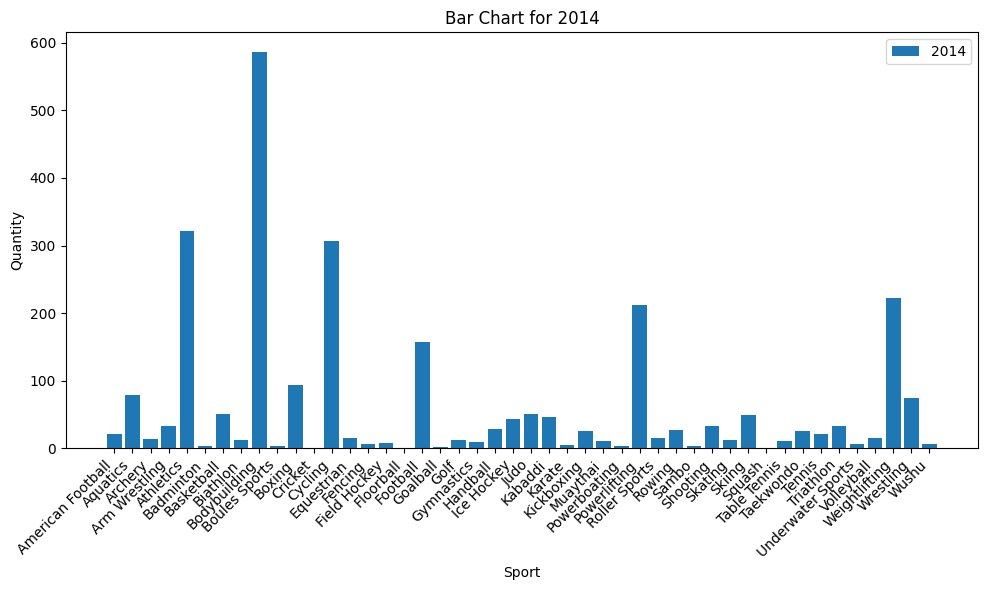

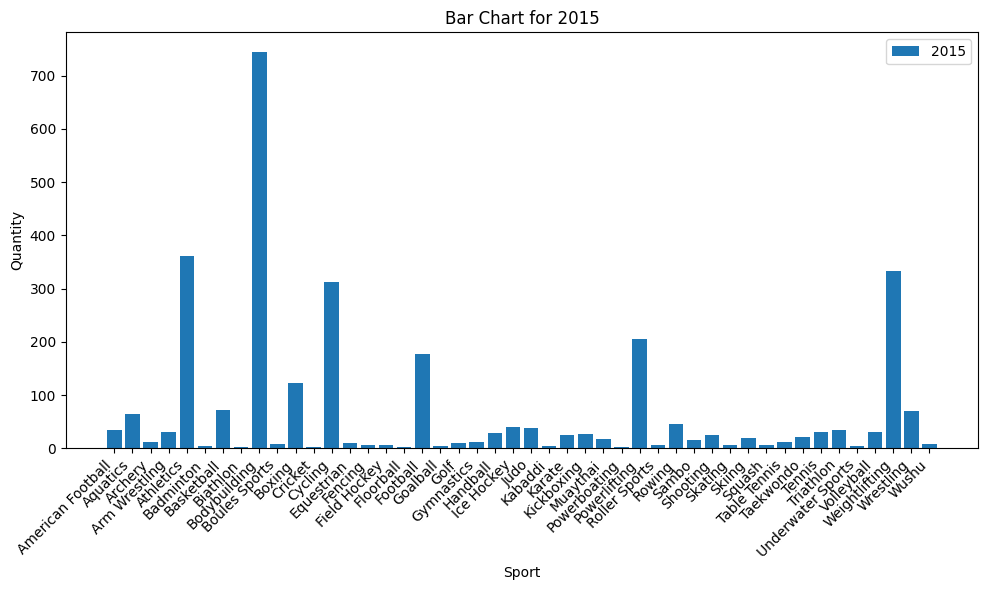

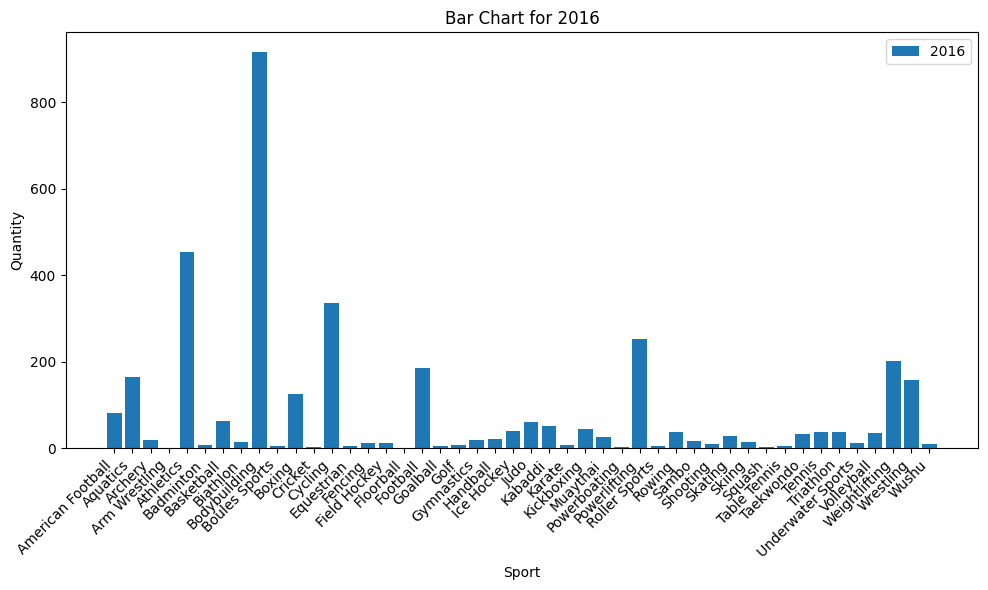

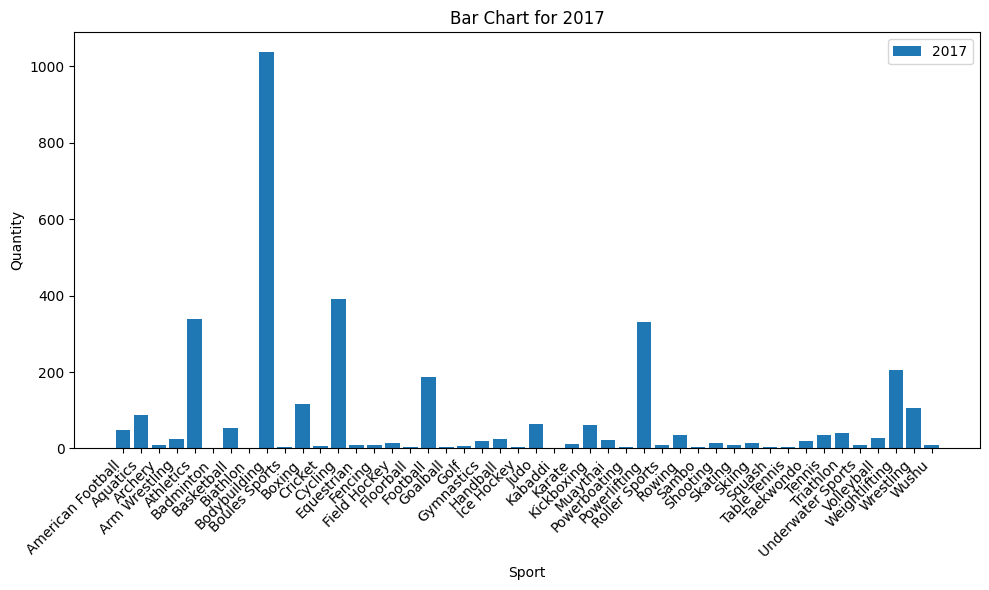

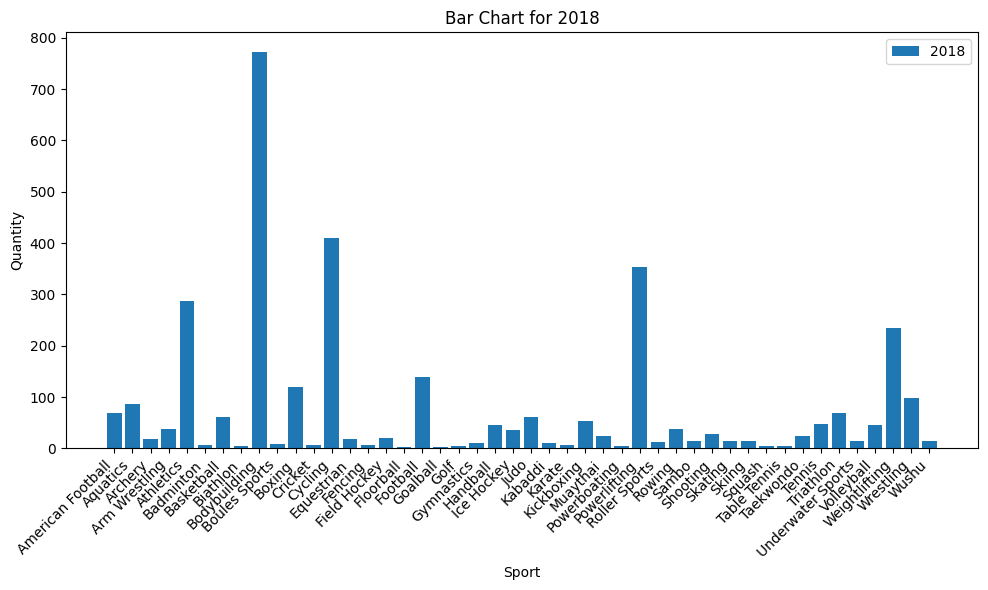

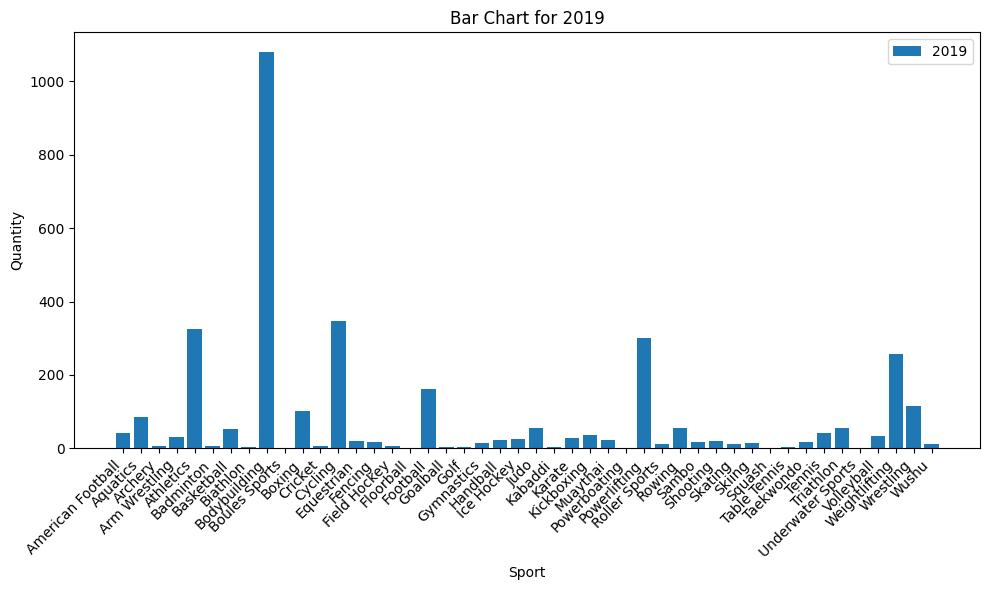

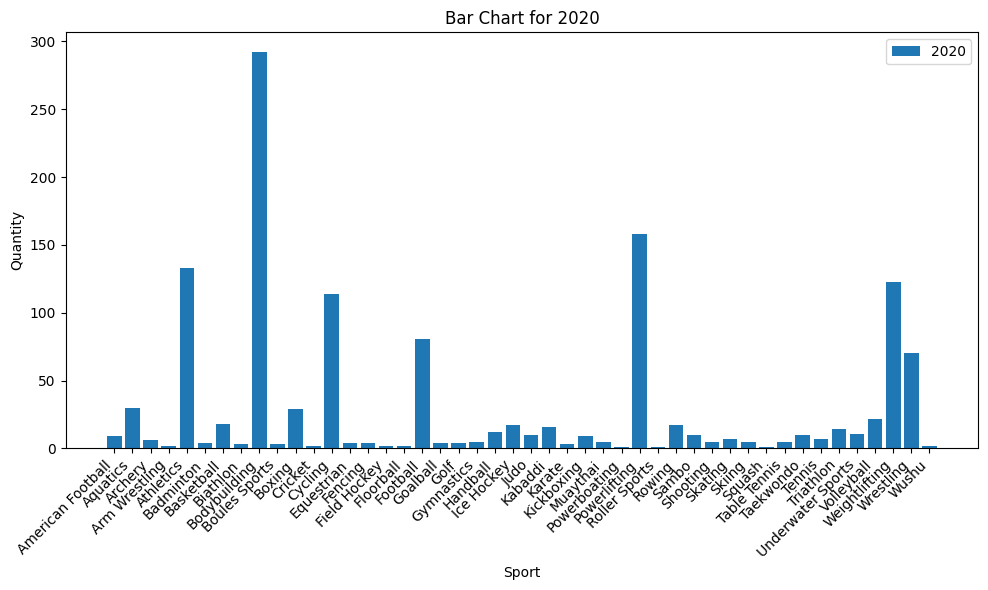

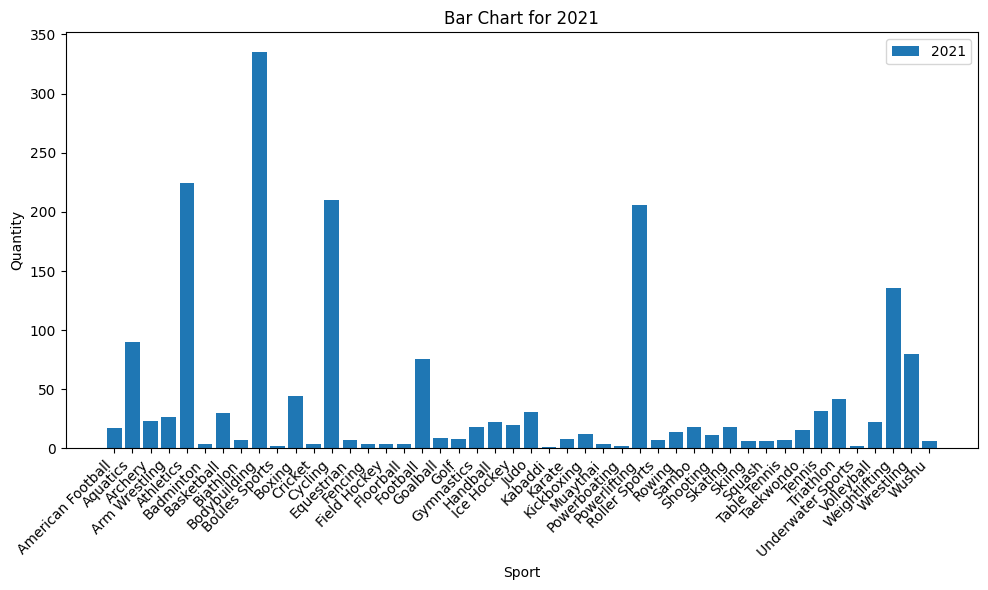

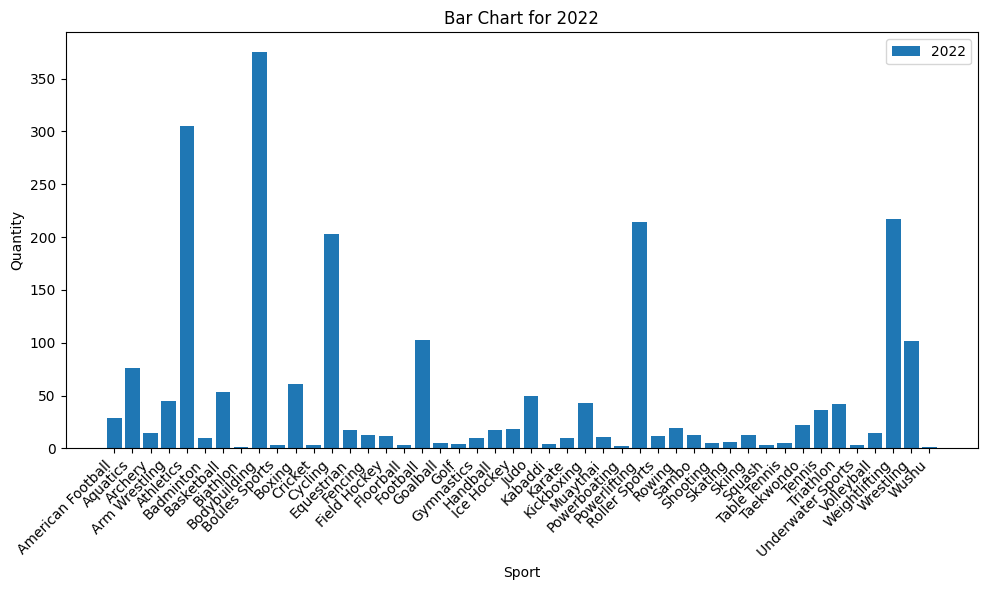

In [7]:
import matplotlib.pyplot as plt
import pandas as pd
import unicodedata

for sheet, df in tables.items():
    plt.figure(figsize=(10, 6))  # Adjust figure size as needed

    # Filter data for common sports in the current sheet
    filtered_df = df[df[df.columns[0]].isin(common_sports)]

    # Extract data for the bar chart
    sports = filtered_df[filtered_df.columns[0]].values

    # Get the last column (Total)
    quantities = filtered_df[filtered_df.columns[-1]].values

    # Create the bar chart
    plt.bar(sports, quantities, label=sheet)

    plt.xlabel("Sport")  # Set the x-axis label
    plt.ylabel("Quantity")  # Set the y-axis label
    plt.title(f"Bar Chart for {sheet}")  # Set title
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
    plt.legend()  # Show the legend
    plt.tight_layout()  # Adjust layout to prevent labels from overlapping
    plt.show()

### Stacked Histograms: Doping Methods for Each Sport
For each common sport, creates stacked bar charts (one per year) to show breakdown by doping method (e.g., S1, S2, etc.). Reveals substance-specific trends within each sport.

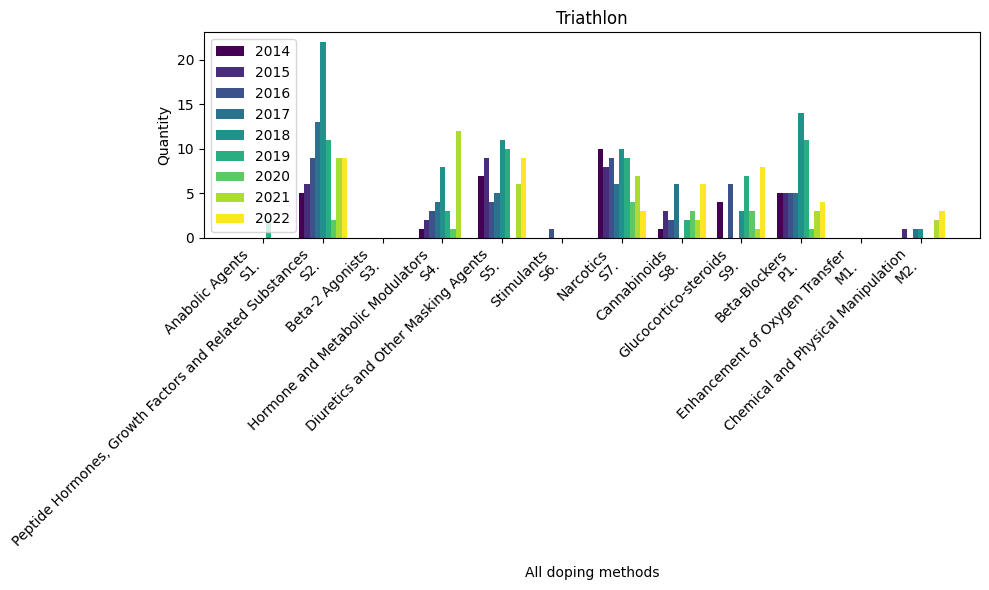

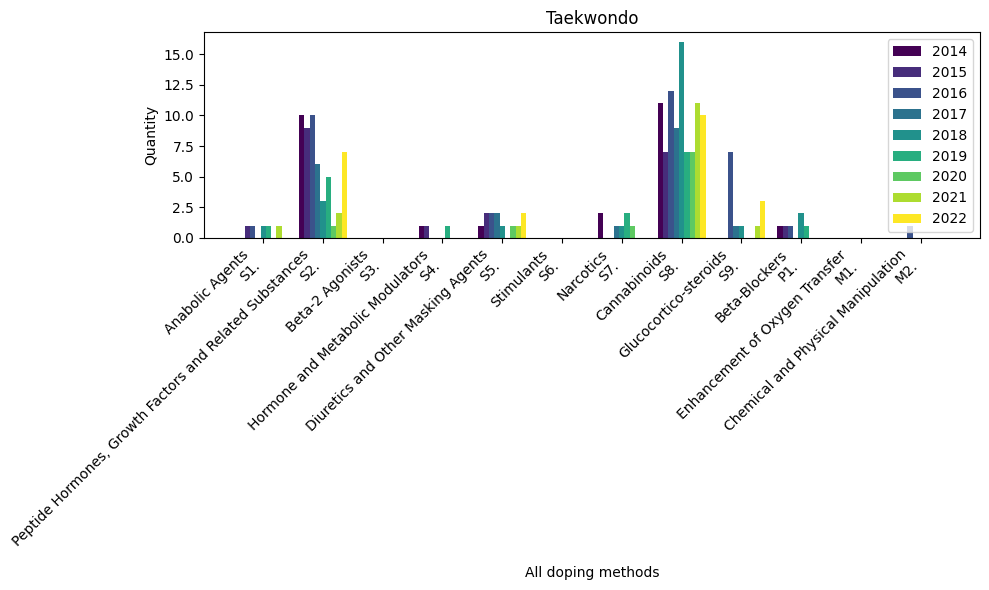

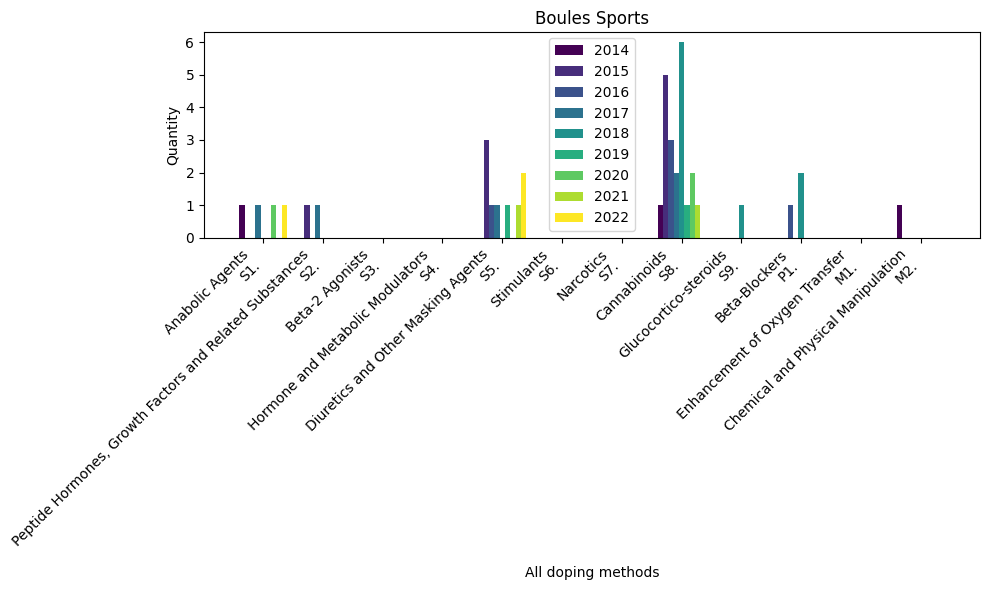

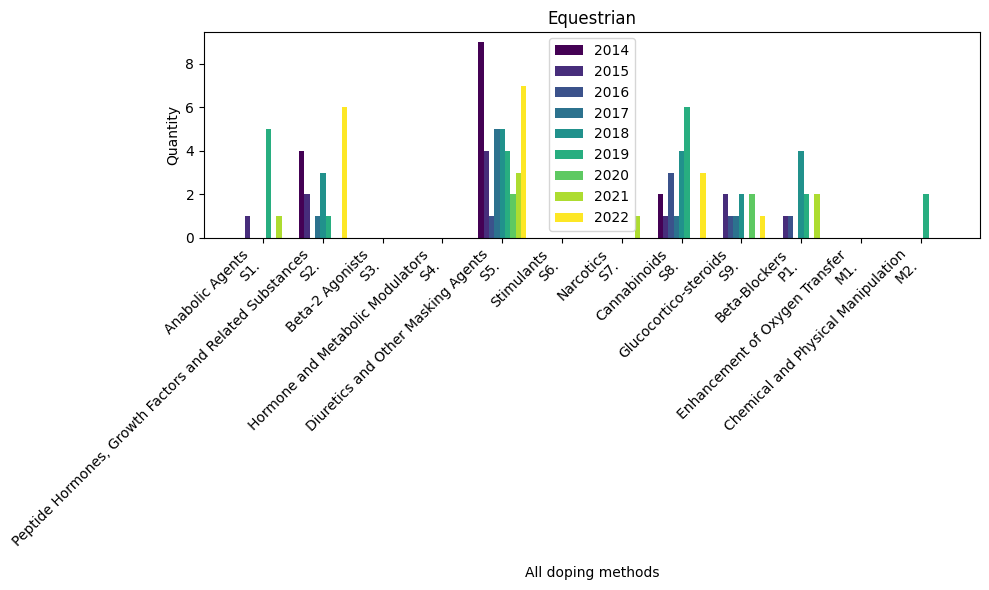

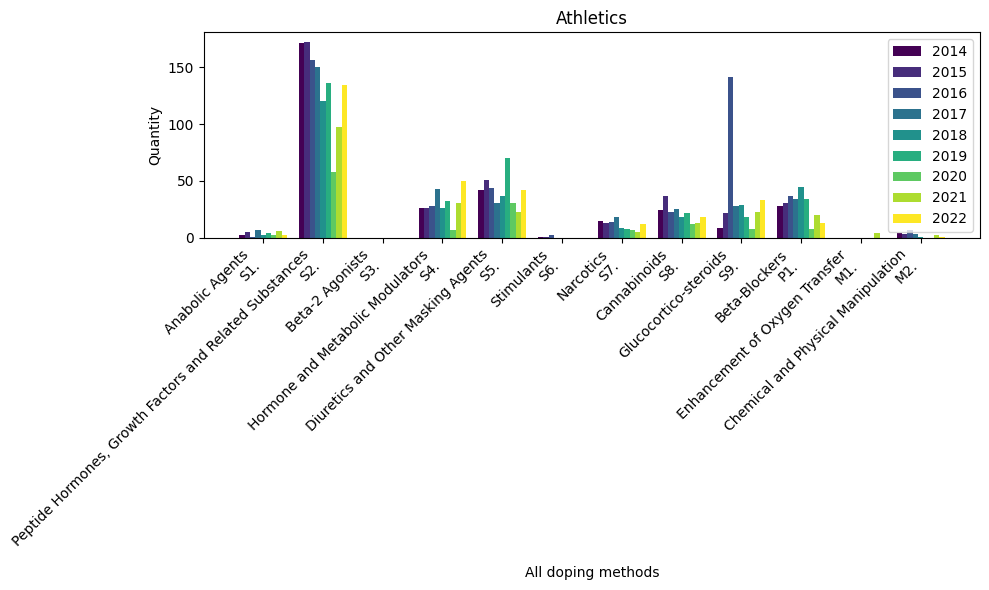

...

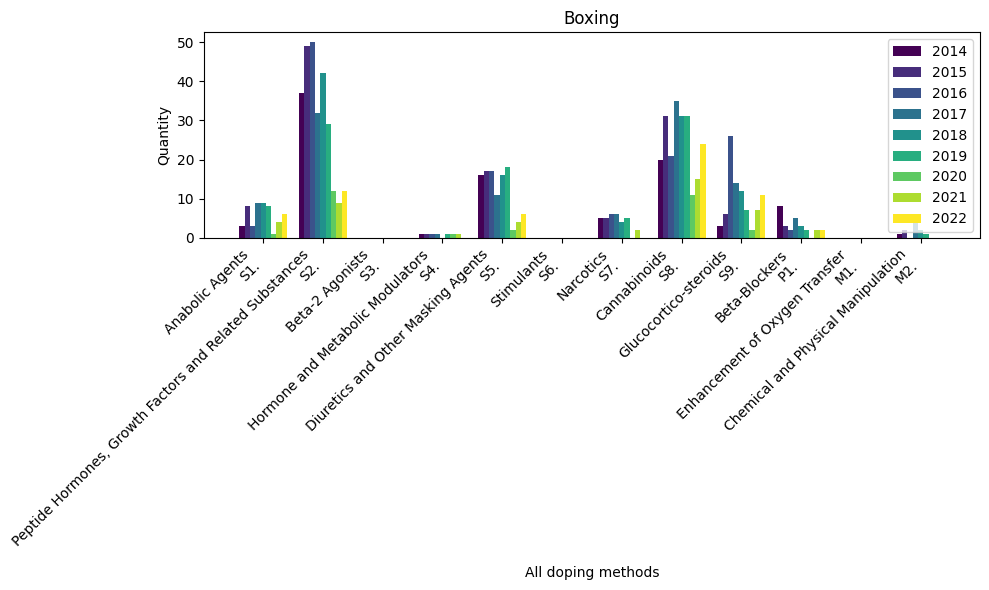

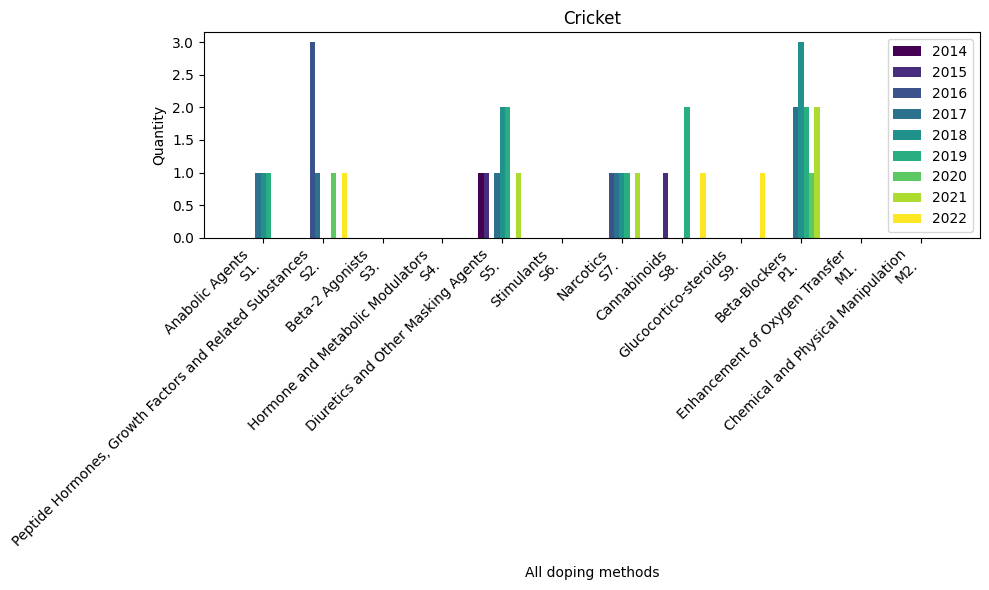

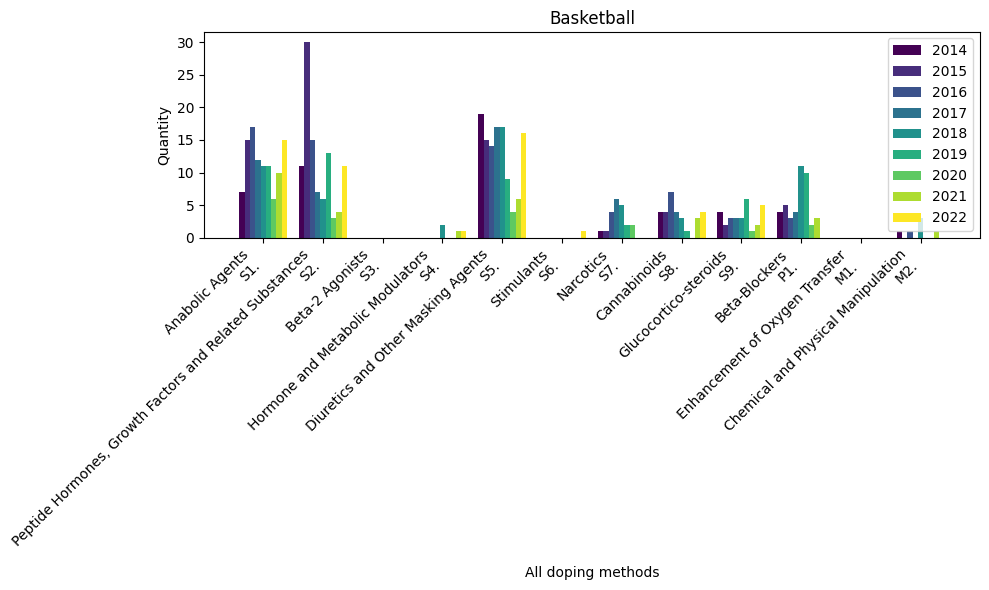

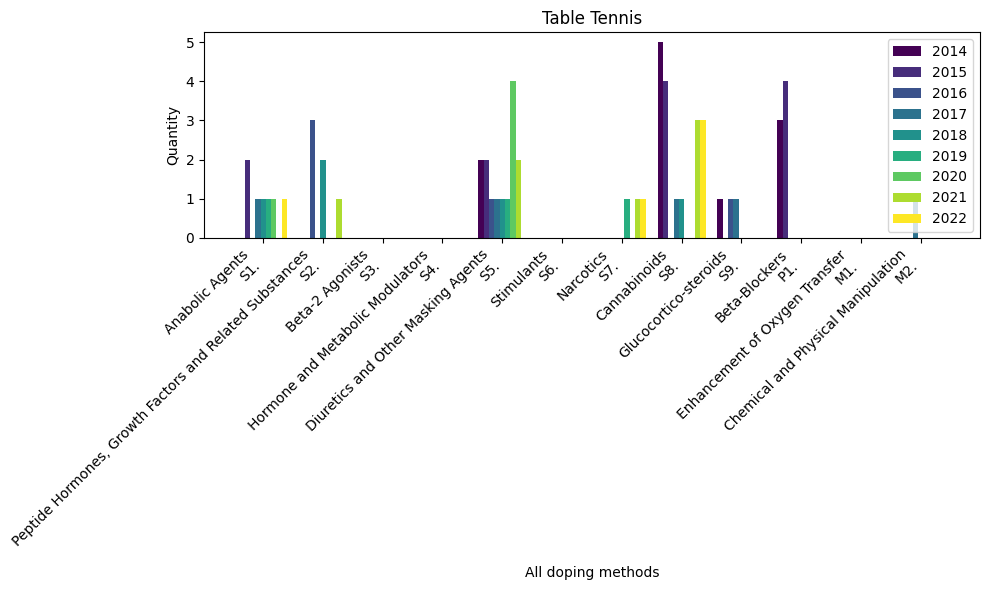

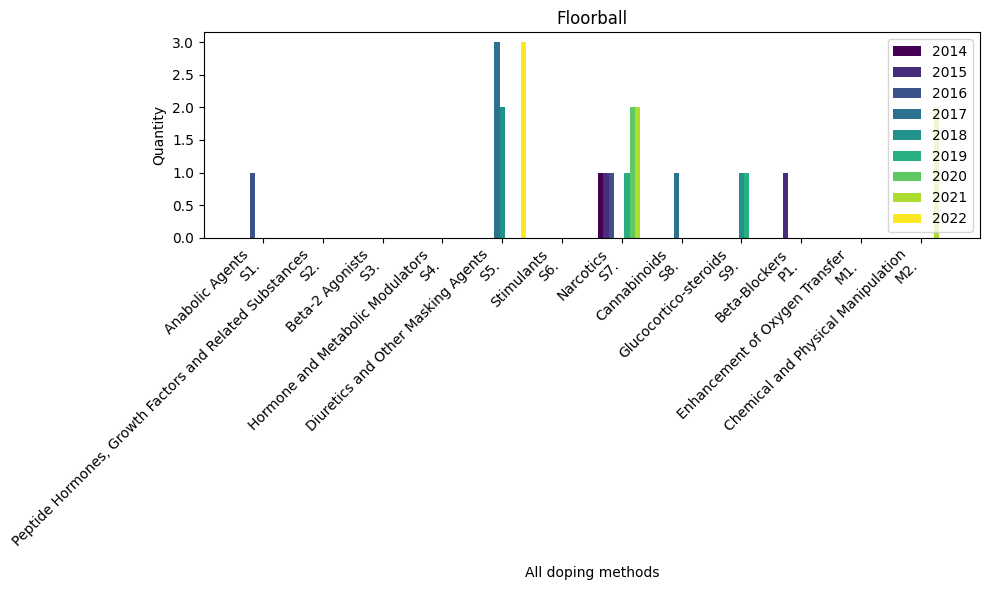

In [8]:
import matplotlib.pyplot as plt
import numpy as np

# Specify desired columns if not already defined
if 'desired_columns' not in globals():
    desired_columns = tables['2014'].columns[1:13]

# Create a histogram for each sport in common_sports
for sport in common_sports:
    plt.figure(figsize=(10, 6))
    all_years_data = {}
    for sheet, df in tables.items():
        filtered_df = df[df[df.columns[0]] == sport]
        if not filtered_df.empty:
            # Find common columns
            cols_to_use = list(set(desired_columns) & set(filtered_df.columns))
            column_data = filtered_df[cols_to_use].values.flatten()

            # Pad or truncate as needed
            num_desired_cols = len(desired_columns)
            if len(column_data) < num_desired_cols:
                column_data = np.pad(column_data, (0, num_desired_cols - len(column_data)), 'constant', constant_values=0)
            else:
                column_data = column_data[:num_desired_cols]

            all_years_data[sheet] = column_data

    x_pos = np.arange(len(desired_columns))
    width = 0.8 / len(tables)
    colors = plt.get_cmap('viridis', len(tables))

    for i, (sheet, column_data) in enumerate(all_years_data.items()):
        plt.bar(x_pos + i * width, column_data, width=width, label=sheet, color=colors(i))

    plt.xlabel("All doping methods")
    plt.ylabel("Quantity")
    plt.title(f"{sport}")
    plt.xticks(x_pos + width * (len(tables) - 1) / 2, desired_columns, rotation=45, ha='right')
    plt.legend()
    plt.tight_layout()
    plt.show()

# Unsupervised Clustering & Dimensionality Reduction of Doping Profiles



**Feature Engineering for Clustering**
* Build Feature Matrix for Common Sports
* Normalize/Pad Feature Vectors if Needed

**Dimensionality Reduction**
* PCA: Principal Component Analysis
* t-SNE: t-distributed Stochastic Neighbor Embedding
* UMAP: Uniform Manifold Approximation and Projection
* 2D Visualization of Sports Profiles

**Unsupervised Clustering**
* K-Means Clustering
* Hierarchical (Agglomerative) Clustering
* Visualize Cluster Assignments

**Cluster Evaluation**
* Silhouette Analysis
* Elbow Method for Cluster Selection

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


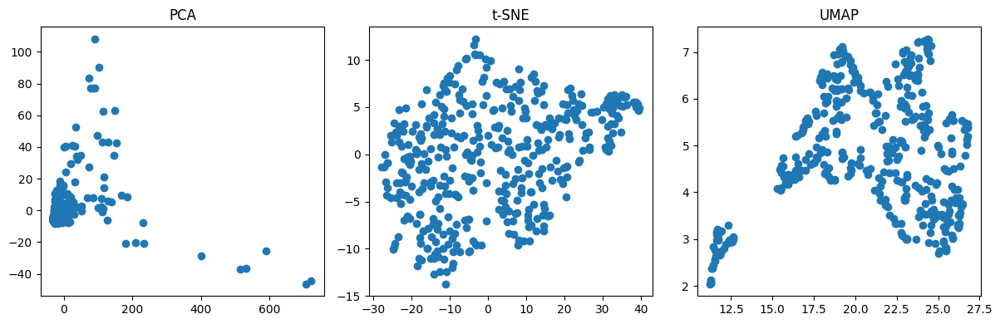

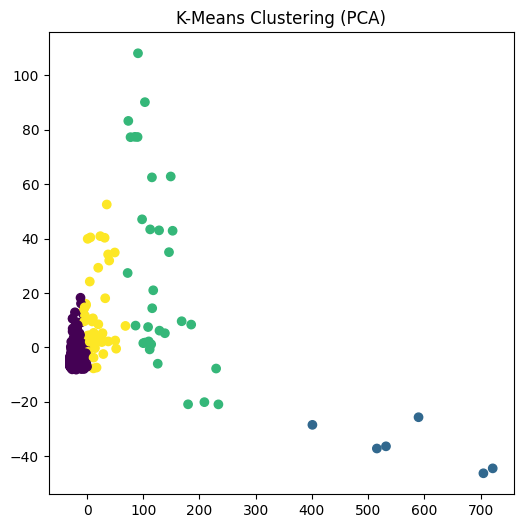

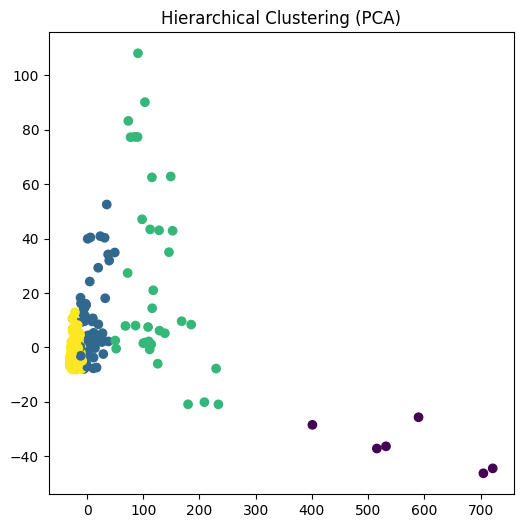

In [9]:
# prompt: Unsupervised Clustering & Dimensionality Reduction
# Goal: Discover groups of sports with similar doping profiles
# Feature Matrix: For each sport, aggregate its per-class percentages (e.g. S1–M1 counts normalized by total).
# Methods:
# PCA / t-SNE / UMAP for 2D visualization of sport “doping fingerprints.”
# K-means & Hierarchical Clustering to segment sports into clusters (e.g. “stimulant-heavy” vs. “anabolic-heavy”).

# Assuming 'tables' dictionary and 'common_sports' are defined as in the previous code.

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap

# Concatenate data for all common sports across all years
all_sports_data = []
sport_names = []
for sport in common_sports:
    for sheet, df in tables.items():
        filtered_df = df[df[df.columns[0]] == sport]
        if not filtered_df.empty:
            # Exclude the last column (Total)
            all_sports_data.append(filtered_df.iloc[:, 1:-1].values.flatten())
            sport_names.append(f"{sport}_{sheet}")

# Handle inconsistent data dimensions (padding or truncation)
max_len = max(len(data) for data in all_sports_data)
padded_data = [np.pad(data, (0, max_len - len(data)), 'constant') for data in all_sports_data]

# Convert the list of arrays to a NumPy array
X = np.array(padded_data)


# Apply PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X)

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_result = tsne.fit_transform(X)


# Apply UMAP
reducer = umap.UMAP(n_components=2, random_state=42)
umap_result = reducer.fit_transform(X)


# Plotting the results
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.scatter(pca_result[:, 0], pca_result[:, 1])
plt.title("PCA")

plt.subplot(1, 3, 2)
plt.scatter(tsne_result[:, 0], tsne_result[:, 1])
plt.title("t-SNE")

plt.subplot(1, 3, 3)
plt.scatter(umap_result[:, 0], umap_result[:, 1])
plt.title("UMAP")

plt.tight_layout()
plt.show()

# K-means Clustering
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=4, random_state=42) # You can adjust n_clusters
kmeans_labels = kmeans.fit_predict(X)


# Hierarchical Clustering
from sklearn.cluster import AgglomerativeClustering

hierarchical = AgglomerativeClustering(n_clusters=4) # You can adjust n_clusters
hierarchical_labels = hierarchical.fit_predict(X)

# Visualize clusters (example with PCA) - replace pca_result with other methods
plt.figure(figsize=(6, 6))
plt.scatter(pca_result[:, 0], pca_result[:, 1], c=kmeans_labels)
plt.title("K-Means Clustering (PCA)")
plt.show()

plt.figure(figsize=(6, 6))
plt.scatter(pca_result[:, 0], pca_result[:, 1], c=hierarchical_labels)
plt.title("Hierarchical Clustering (PCA)")
plt.show()


Dimensionality reduction methods (PCA, t-SNE, and UMAP) were used to project the high-dimensional doping profiles of sports into two dimensions, making group patterns and outliers visible. Clustering algorithms (K-Means and Hierarchical) applied to these projections revealed distinct groups of sports with similar substance usage profiles, highlighting both clear clusters and hierarchical relationships in doping behaviors across sports.


### Cluster Memberships
Records and prints cluster assignments for each sport and year, for both K-Means and Hierarchical methods.

In [10]:
# Create a dictionary to store cluster assignments
cluster_assignments = {}

# Iterate through sport names and cluster labels
for i, label in enumerate(kmeans_labels):
    cluster_assignments.setdefault(label, []).append(sport_names[i])  # Assign sport to cluster

# Print cluster assignments
print("=== K-Means Clusters ===")
for cluster_id, sports in cluster_assignments.items():
    print(f"{np.int32(cluster_id)}: {sports}")

# Create a dictionary to store cluster assignments
cluster_assignments_hierarchical = {}

# Iterate through sport names and cluster labels
for i, label in enumerate(hierarchical_labels):  # Use hierarchical_labels here
    cluster_assignments_hierarchical.setdefault(label, []).append(sport_names[i])

# Print cluster assignments
print("=== Hierarchical Clusters ===")
for cluster_id, sports in cluster_assignments_hierarchical.items():
    print(f"{np.int32(cluster_id)}: {sports}")

=== K-Means Clusters ===
0: ['Triathlon_2014', 'Triathlon_2015', 'Triathlon_2016', 'Triathlon_2017', 'Triathlon_2018', 'Triathlon_2019', 'Triathlon_2020', 'Triathlon_2021', 'Triathlon_2022', 'Taekwondo_2014', 'Taekwondo_2015', 'Taekwondo_2016', 'Taekwondo_2017', 'Taekwondo_2018', 'Taekwondo_2019', 'Taekwondo_2020', 'Taekwondo_2021', 'Taekwondo_2022', 'Boules Sports_2014', 'Boules Sports_2015', 'Boules Sports_2016', 'Boules Sports_2017', 'Boules Sports_2018', 'Boules Sports_2019', 'Boules Sports_2020', 'Boules Sports_2021', 'Boules Sports_2022', 'Equestrian_2014', 'Equestrian_2015', 'Equestrian_2016', 'Equestrian_2017', 'Equestrian_2018', 'Equestrian_2019', 'Equestrian_2020', 'Equestrian_2021', 'Equestrian_2022', 'Judo_2014', 'Judo_2015', 'Judo_2016', 'Judo_2017', 'Judo_2018', 'Judo_2019', 'Judo_2020', 'Judo_2021', 'Judo_2022', 'Powerboating_2014', 'Powerboating_2015', 'Powerboating_2016', 'Powerboating_2017', 'Powerboating_2018', 'Powerboating_2019', 'Powerboating_2020', 'Powerboating_

### Silhouette Analysis
Calculates silhouette scores to assess the quality and separability of the discovered clusters for multiple values of k (number of clusters).

In [11]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans, AgglomerativeClustering

k_range = range(2, 7)  # Clusters from 2 to 6

# Silhouette analysis for K-Means
silhouette_scores_kmeans = [
    silhouette_score(X, KMeans(n_clusters=k, random_state=42).fit_predict(X))
    for k in k_range
]

# Silhouette analysis for Hierarchical
silhouette_scores_hierarchical = [
    silhouette_score(X, AgglomerativeClustering(n_clusters=k, linkage='ward').fit_predict(X))
    for k in k_range
]

# Print results
print("Silhouette Scores for K-Means:")
for k, score in zip(k_range, silhouette_scores_kmeans):
    print(f"k={k}: {score}")

print("\nSilhouette Scores for Hierarchical Clustering:")
for k, score in zip(k_range, silhouette_scores_hierarchical):
    print(f"k={k}: {score}")

Silhouette Scores for K-Means:
k=2: 0.9219336906563274
k=3: 0.8281840495025682
k=4: 0.674389461224415
k=5: 0.6732739033875352
k=6: 0.6716645561138065

Silhouette Scores for Hierarchical Clustering:
k=2: 0.9219336906563274
k=3: 0.8255323322992209
k=4: 0.6200348115457978
k=5: 0.6188669695308826
k=6: 0.6161728044754469


### Elbow Method for Cluster Selection
Uses inertia plots (within-cluster sum of squares) to help select an optimal number of clusters for both K-Means and Hierarchical methods.

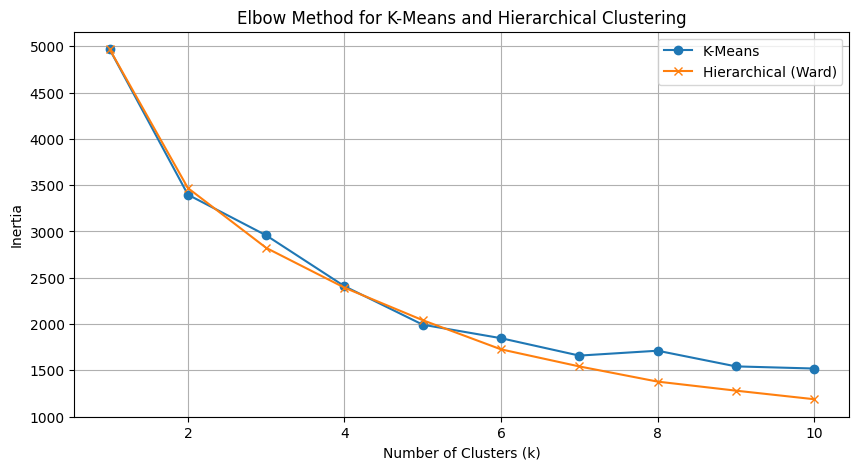

In [12]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler  # Import StandardScaler

# Range of k values to evaluate
k_range = range(1, 11)  # You can adjust the range as needed

# --- Scale Your Data (Important!) ---
scaler = StandardScaler()  # Initialize StandardScaler
X_scaled = scaler.fit_transform(X)  # Fit and transform your data

# K-Means Elbow Method
inertias_kmeans = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)  # Use scaled data for K-Means
    inertias_kmeans.append(kmeans.inertia_)

# Hierarchical Elbow Method (using Ward's linkage)
inertias_hierarchical = []
for k in k_range:
    hierarchical = AgglomerativeClustering(n_clusters=k, linkage='ward')
    hierarchical.fit(X_scaled)  # Use scaled data for Hierarchical clustering

    # Calculate inertia for hierarchical clustering manually
    labels = hierarchical.labels_
    inertia = 0
    for i in range(k):
        cluster_points = X_scaled[labels == i]  # Use scaled data
        cluster_center = np.mean(cluster_points, axis=0)
        inertia += np.sum((cluster_points - cluster_center)**2)
    inertias_hierarchical.append(inertia)

# Plot the inertia curves
plt.figure(figsize=(10, 5))  # Adjust figure size as needed
plt.plot(k_range, inertias_kmeans, marker='o', label='K-Means')
plt.plot(k_range, inertias_hierarchical, marker='x', label='Hierarchical (Ward)')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method for K-Means and Hierarchical Clustering')
plt.legend()
plt.grid(True)
plt.show()

### Dendrogram: Hierarchical Clustering of Sports
Generates and displays a dendrogram showing how sports are grouped hierarchically, visualizing merging distances.

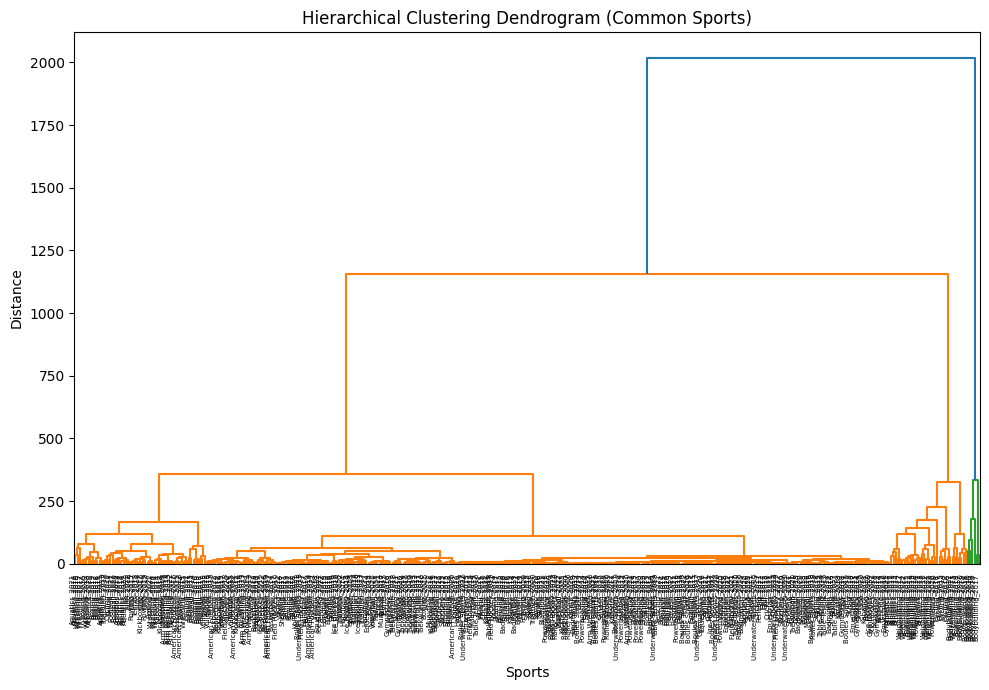

In [13]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from scipy.cluster.hierarchy import dendrogram, linkage

# Concatenate data for all common sports across all years
all_sports_data = []
sport_names = []
for sport in common_sports:
    for sheet, df in tables.items():
        filtered_df = df[df[df.columns[0]] == sport]
        if not filtered_df.empty:
            # Select columns 2 to 13 (index 1 to 12)
            all_sports_data.append(filtered_df.iloc[:, 1:13].values.flatten())
            sport_names.append(f"{sport}_{sheet}")

# Handle inconsistent data dimensions (padding or truncation)
max_len = max(len(data) for data in all_sports_data)
padded_data = [np.pad(data, (0, max_len - len(data)), 'constant') for data in all_sports_data]

# Convert the list of arrays to a NumPy array
X = np.array(padded_data)

# Filter X and sport_names to include only common_sports
common_sports_indices = [i for i, name in enumerate(sport_names) if name.split('_')[0] in common_sports]
X_common = X[common_sports_indices]
sport_names_common = [sport_names[i] for i in common_sports_indices]

# Perform hierarchical clustering on the filtered data
linked = linkage(X_common, 'ward')

# Plot the dendrogram
plt.figure(figsize=(10, 7))
dendrogram(linked,
            orientation='top',
            labels=sport_names_common,
            distance_sort='descending',
            show_leaf_counts=True)
plt.title('Hierarchical Clustering Dendrogram (Common Sports)')
plt.xlabel('Sports')
plt.ylabel('Distance')
plt.xticks(rotation=90, ha='right')
plt.tight_layout()
plt.show()

### Per-Category (Substance) Hierarchical Clustering of Sports by Doping Substance
For each substance category (e.g., S1, S2…), performs hierarchical clustering across all sport-year entries using only that substance.
Visualizes and lists which sports cluster together for each substance, highlighting category-specific patterns.

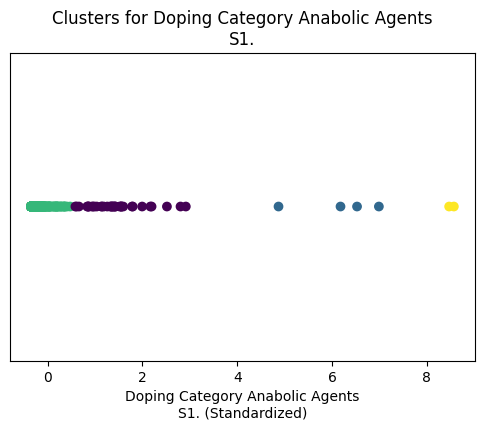

Clusters for Doping Category Anabolic Agents
S1.:
  Cluster 0: ['Athletics_2014', 'Athletics_2015', 'Athletics_2016', 'Athletics_2017', 'Athletics_2018', 'Athletics_2019', 'Athletics_2021', 'Athletics_2022', 'Cycling_2014', 'Cycling_2015', 'Cycling_2016', 'Cycling_2017', 'Cycling_2018', 'Cycling_2019', 'Powerlifting_2014', 'Powerlifting_2015', 'Powerlifting_2016', 'Powerlifting_2017', 'Powerlifting_2018', 'Powerlifting_2019', 'Powerlifting_2020', 'Powerlifting_2021', 'Powerlifting_2022', 'Weightlifting_2014', 'Weightlifting_2015', 'Weightlifting_2016', 'Weightlifting_2017', 'Weightlifting_2018', 'Weightlifting_2019', 'Weightlifting_2020', 'Weightlifting_2021', 'Weightlifting_2022', 'Bodybuilding_2020', 'Bodybuilding_2021', 'Bodybuilding_2022', 'Football_2016']
  Cluster 1: ['Bodybuilding_2014', 'Bodybuilding_2015', 'Bodybuilding_2016', 'Bodybuilding_2018']
  Cluster 2: ['Triathlon_2014', 'Triathlon_2015', 'Triathlon_2016', 'Triathlon_2017', 'Triathlon_2018', 'Triathlon_2019', 'Triathlo

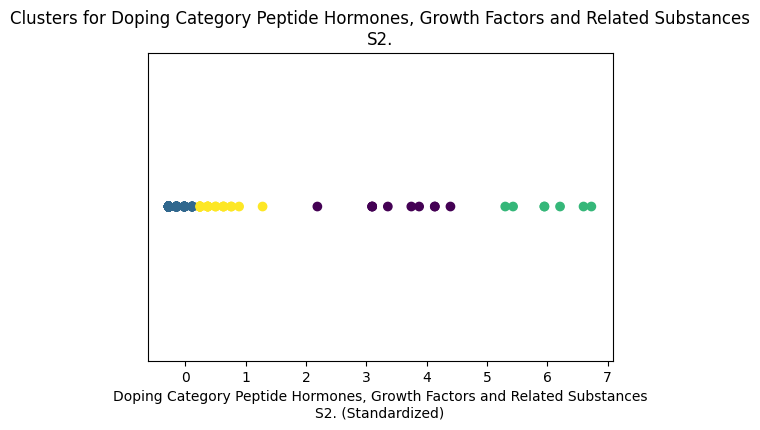

Clusters for Doping Category Peptide Hormones, Growth Factors and Related Substances
S2.:
  Cluster 0: ['Athletics_2014', 'Athletics_2015', 'Athletics_2016', 'Athletics_2018', 'Athletics_2019', 'Athletics_2021', 'Cycling_2015', 'Cycling_2020', 'Cycling_2021', 'Cycling_2022']
  Cluster 1: ['Triathlon_2014', 'Triathlon_2015', 'Triathlon_2016', 'Triathlon_2019', 'Triathlon_2020', 'Triathlon_2022', 'Taekwondo_2014', 'Taekwondo_2015', 'Taekwondo_2016', 'Taekwondo_2017', 'Taekwondo_2018', 'Taekwondo_2019', 'Taekwondo_2020', 'Taekwondo_2021', 'Taekwondo_2022', 'Boules Sports_2014', 'Boules Sports_2015', 'Boules Sports_2016', 'Boules Sports_2017', 'Boules Sports_2018', 'Boules Sports_2019', 'Boules Sports_2020', 'Boules Sports_2021', 'Boules Sports_2022', 'Equestrian_2014', 'Equestrian_2015', 'Equestrian_2016', 'Equestrian_2017', 'Equestrian_2018', 'Equestrian_2019', 'Equestrian_2020', 'Equestrian_2021', 'Equestrian_2022', 'Judo_2014', 'Judo_2015', 'Judo_2016', 'Judo_2017', 'Judo_2018', 'Judo_

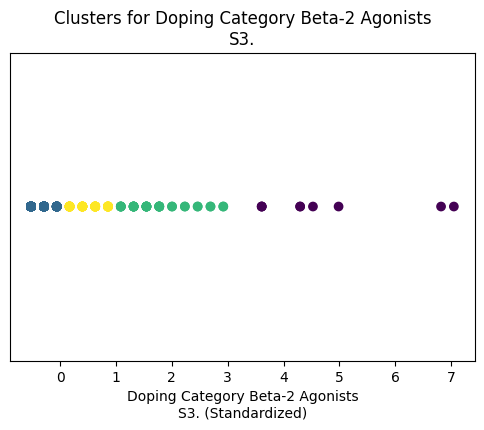

Clusters for Doping Category Beta‐2 Agonists
S3.:
  Cluster 0: ['Athletics_2017', 'Cycling_2014', 'Cycling_2015', 'Cycling_2016', 'Cycling_2017', 'Cycling_2018', 'Cycling_2019', 'Powerlifting_2018', 'Aquatics_2016']
  Cluster 1: ['Taekwondo_2014', 'Taekwondo_2015', 'Taekwondo_2016', 'Taekwondo_2017', 'Taekwondo_2018', 'Taekwondo_2019', 'Taekwondo_2020', 'Taekwondo_2021', 'Taekwondo_2022', 'Boules Sports_2014', 'Boules Sports_2015', 'Boules Sports_2016', 'Boules Sports_2017', 'Boules Sports_2018', 'Boules Sports_2019', 'Boules Sports_2020', 'Boules Sports_2021', 'Boules Sports_2022', 'Equestrian_2014', 'Equestrian_2015', 'Equestrian_2016', 'Equestrian_2017', 'Equestrian_2018', 'Equestrian_2019', 'Equestrian_2020', 'Equestrian_2021', 'Equestrian_2022', 'Judo_2015', 'Judo_2017', 'Judo_2019', 'Judo_2020', 'Judo_2021', 'Judo_2022', 'Powerboating_2014', 'Powerboating_2015', 'Powerboating_2016', 'Powerboating_2017', 'Powerboating_2018', 'Powerboating_2019', 'Powerboating_2020', 'Powerboating_

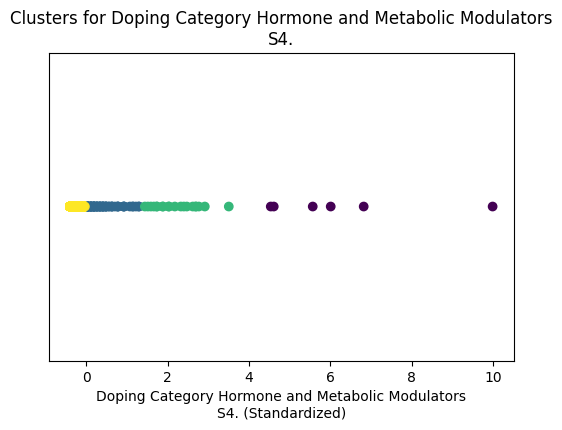

Clusters for Doping Category Hormone and Metabolic Modulators
S4.:
  Cluster 0: ['Athletics_2016', 'Wrestling_2016', 'Bodybuilding_2016', 'Bodybuilding_2017', 'Bodybuilding_2018', 'Bodybuilding_2019']
  Cluster 1: ['Triathlon_2016', 'Triathlon_2019', 'Triathlon_2022', 'Taekwondo_2016', 'Athletics_2014', 'Athletics_2015', 'Athletics_2019', 'Athletics_2020', 'Athletics_2021', 'Judo_2016', 'Judo_2017', 'Judo_2022', 'Tennis_2016', 'Kickboxing_2016', 'Kickboxing_2017', 'Kickboxing_2019', 'Skating_2016', 'Cycling_2017', 'Cycling_2018', 'Cycling_2019', 'Cycling_2020', 'Cycling_2021', 'Cycling_2022', 'Skiing_2016', 'Rowing_2016', 'Wrestling_2017', 'Wrestling_2018', 'Wrestling_2019', 'Wrestling_2020', 'Wrestling_2021', 'Wrestling_2022', 'Powerlifting_2014', 'Powerlifting_2015', 'Powerlifting_2020', 'Sambo_2016', 'Ice Hockey_2016', 'Ice Hockey_2018', 'Biathlon_2016', 'Aquatics_2017', 'Aquatics_2018', 'Aquatics_2022', 'Weightlifting_2014', 'Weightlifting_2015', 'Weightlifting_2017', 'Weightliftin

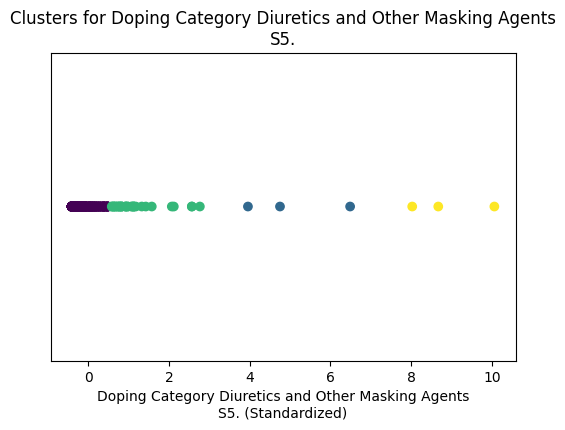

Clusters for Doping Category Diuretics and Other Masking Agents
S5.:
  Cluster 0: ['Triathlon_2014', 'Triathlon_2015', 'Triathlon_2016', 'Triathlon_2017', 'Triathlon_2018', 'Triathlon_2019', 'Triathlon_2020', 'Triathlon_2021', 'Triathlon_2022', 'Taekwondo_2014', 'Taekwondo_2015', 'Taekwondo_2016', 'Taekwondo_2017', 'Taekwondo_2018', 'Taekwondo_2019', 'Taekwondo_2020', 'Taekwondo_2021', 'Taekwondo_2022', 'Boules Sports_2014', 'Boules Sports_2015', 'Boules Sports_2016', 'Boules Sports_2017', 'Boules Sports_2018', 'Boules Sports_2019', 'Boules Sports_2020', 'Boules Sports_2021', 'Boules Sports_2022', 'Equestrian_2014', 'Equestrian_2015', 'Equestrian_2016', 'Equestrian_2017', 'Equestrian_2018', 'Equestrian_2019', 'Equestrian_2020', 'Equestrian_2021', 'Equestrian_2022', 'Athletics_2018', 'Athletics_2020', 'Athletics_2021', 'Athletics_2022', 'Judo_2014', 'Judo_2015', 'Judo_2016', 'Judo_2017', 'Judo_2018', 'Judo_2020', 'Judo_2021', 'Judo_2022', 'Powerboating_2014', 'Powerboating_2015', 'Power

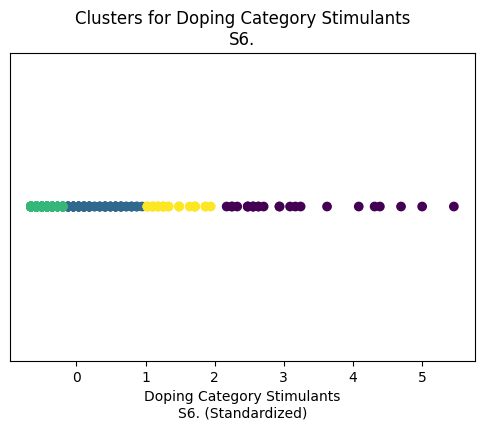

Clusters for Doping Category Stimulants
S6.:
  Cluster 0: ['Athletics_2014', 'Athletics_2015', 'Athletics_2016', 'Athletics_2018', 'Athletics_2019', 'Athletics_2022', 'Cycling_2014', 'Cycling_2015', 'Cycling_2016', 'Cycling_2017', 'Cycling_2018', 'Cycling_2019', 'Cycling_2021', 'Cycling_2022', 'Powerlifting_2017', 'Powerlifting_2018', 'Weightlifting_2019', 'Bodybuilding_2016', 'Bodybuilding_2019', 'Football_2014', 'Football_2015', 'Football_2016', 'Football_2017', 'Football_2018', 'Football_2019']
  Cluster 1: ['Triathlon_2014', 'Triathlon_2015', 'Triathlon_2018', 'Triathlon_2019', 'Triathlon_2022', 'Equestrian_2014', 'Equestrian_2022', 'Judo_2014', 'Judo_2015', 'Judo_2017', 'Judo_2018', 'Judo_2019', 'Judo_2022', 'Tennis_2014', 'Tennis_2015', 'Tennis_2017', 'Tennis_2018', 'Tennis_2019', 'Tennis_2021', 'Tennis_2022', 'Gymnastics_2016', 'Gymnastics_2017', 'Gymnastics_2019', 'Kabaddi_2016', 'Kickboxing_2015', 'Kickboxing_2016', 'Kickboxing_2018', 'Kickboxing_2022', 'Cycling_2020', 'Muayth

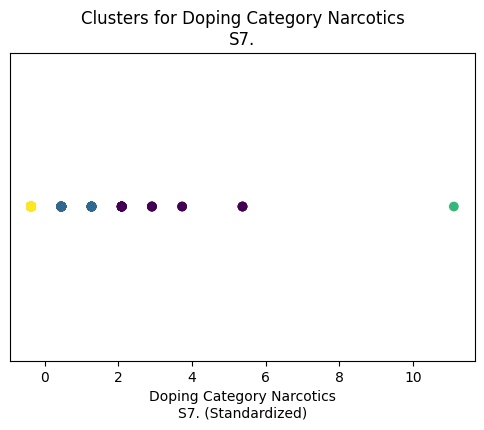

Clusters for Doping Category Narcotics
S7.:
  Cluster 0: ['Triathlon_2022', 'Athletics_2014', 'Athletics_2015', 'Athletics_2016', 'Athletics_2017', 'Powerboating_2016', 'Tennis_2017', 'Kabaddi_2016', 'Cycling_2014', 'Cycling_2015', 'Cycling_2016', 'Cycling_2018', 'Cycling_2022', 'American Football_2014', 'Wrestling_2019', 'Ice Hockey_2021', 'Handball_2016', 'Handball_2017', 'Bodybuilding_2017', 'Football_2017', 'Football_2019', 'Boxing_2017', 'Basketball_2018']
  Cluster 1: ['Triathlon_2015', 'Triathlon_2017', 'Triathlon_2018', 'Triathlon_2021', 'Taekwondo_2016', 'Boules Sports_2014', 'Equestrian_2019', 'Athletics_2018', 'Athletics_2021', 'Athletics_2022', 'Judo_2017', 'Shooting_2014', 'Shooting_2015', 'Shooting_2016', 'Shooting_2022', 'Tennis_2016', 'Kickboxing_2014', 'Kickboxing_2016', 'Kickboxing_2021', 'Cycling_2019', 'Cycling_2021', 'Skiing_2015', 'Rowing_2016', 'American Football_2020', 'Field Hockey_2018', 'Field Hockey_2019', 'Archery_2019', 'Wrestling_2016', 'Wrestling_2021', 

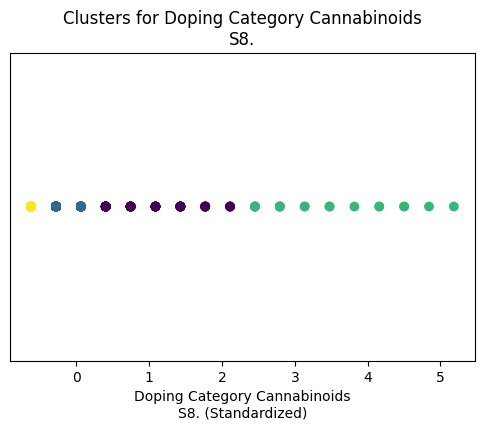

Clusters for Doping Category Cannabinoids
S8.:
  Cluster 0: ['Equestrian_2019', 'Athletics_2015', 'Athletics_2017', 'Athletics_2019', 'Athletics_2021', 'Judo_2015', 'Judo_2018', 'Tennis_2017', 'Tennis_2019', 'Kickboxing_2014', 'Kickboxing_2015', 'Kickboxing_2016', 'Kickboxing_2018', 'Kickboxing_2019', 'Kickboxing_2020', 'Kickboxing_2021', 'Kickboxing_2022', 'Skating_2018', 'Cycling_2015', 'Cycling_2017', 'Cycling_2018', 'Cycling_2021', 'Cycling_2022', 'Karate_2017', 'Muaythai_2018', 'Muaythai_2022', 'American Football_2015', 'American Football_2016', 'American Football_2017', 'American Football_2021', 'American Football_2022', 'Field Hockey_2022', 'Wrestling_2017', 'Wrestling_2019', 'Wrestling_2020', 'Wrestling_2022', 'Powerlifting_2014', 'Powerlifting_2015', 'Powerlifting_2018', 'Ice Hockey_2015', 'Ice Hockey_2016', 'Ice Hockey_2019', 'Aquatics_2015', 'Aquatics_2016', 'Aquatics_2019', 'Weightlifting_2018', 'Weightlifting_2019', 'Weightlifting_2021', 'Weightlifting_2022', 'Volleyball_2

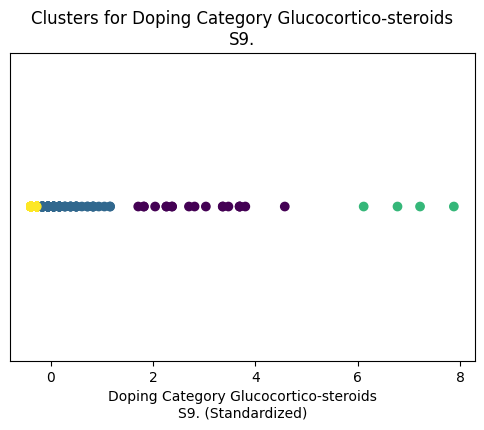

Clusters for Doping Category Glucocortico‐steroids
S9.:
  Cluster 0: ['Athletics_2014', 'Athletics_2015', 'Athletics_2016', 'Athletics_2017', 'Athletics_2018', 'Athletics_2019', 'Athletics_2021', 'Cycling_2016', 'Cycling_2019', 'Cycling_2020', 'Cycling_2021', 'Skiing_2014', 'Football_2014', 'Football_2015', 'Football_2016', 'Football_2017', 'Football_2018', 'Football_2019', 'Football_2020']
  Cluster 1: ['Triathlon_2014', 'Triathlon_2015', 'Triathlon_2016', 'Triathlon_2017', 'Triathlon_2018', 'Triathlon_2019', 'Triathlon_2021', 'Triathlon_2022', 'Taekwondo_2018', 'Boules Sports_2018', 'Equestrian_2018', 'Equestrian_2019', 'Equestrian_2021', 'Athletics_2020', 'Athletics_2022', 'Judo_2014', 'Judo_2017', 'Judo_2018', 'Judo_2021', 'Shooting_2014', 'Tennis_2014', 'Tennis_2015', 'Tennis_2016', 'Tennis_2017', 'Tennis_2018', 'Tennis_2019', 'Tennis_2020', 'Tennis_2021', 'Tennis_2022', 'Gymnastics_2019', 'Gymnastics_2021', 'Kickboxing_2016', 'Kickboxing_2017', 'Kickboxing_2019', 'Skating_2014', 

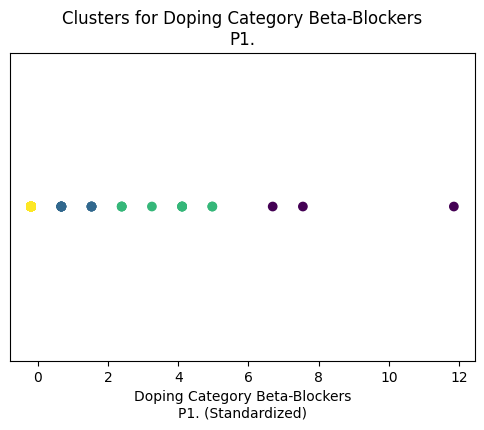

Clusters for Doping Category Beta-Blockers
P1.:
  Cluster 0: ['Shooting_2014', 'Shooting_2015', 'Underwater Sports_2020']
  Cluster 1: ['Shooting_2016', 'Shooting_2017', 'Shooting_2022', 'Golf_2014', 'Golf_2015', 'Golf_2017', 'Golf_2018', 'Golf_2019', 'Golf_2022', 'Archery_2014', 'Archery_2015', 'Archery_2020']
  Cluster 2: ['Shooting_2018', 'Shooting_2019', 'Shooting_2020', 'Shooting_2021', 'Archery_2016', 'Archery_2017', 'Archery_2018', 'Archery_2019', 'Archery_2021', 'Archery_2022']
  Cluster 3: ['Triathlon_2014', 'Triathlon_2015', 'Triathlon_2016', 'Triathlon_2017', 'Triathlon_2018', 'Triathlon_2019', 'Triathlon_2020', 'Triathlon_2021', 'Triathlon_2022', 'Taekwondo_2014', 'Taekwondo_2015', 'Taekwondo_2016', 'Taekwondo_2017', 'Taekwondo_2018', 'Taekwondo_2019', 'Taekwondo_2020', 'Taekwondo_2021', 'Taekwondo_2022', 'Boules Sports_2014', 'Boules Sports_2015', 'Boules Sports_2016', 'Boules Sports_2017', 'Boules Sports_2018', 'Boules Sports_2019', 'Boules Sports_2020', 'Boules Sports_20

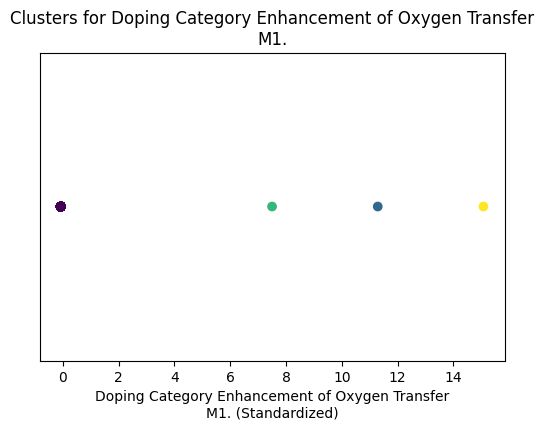

Clusters for Doping Category Enhancement of Oxygen Transfer
M1.:
  Cluster 0: ['Triathlon_2014', 'Triathlon_2015', 'Triathlon_2016', 'Triathlon_2017', 'Triathlon_2018', 'Triathlon_2019', 'Triathlon_2020', 'Triathlon_2021', 'Triathlon_2022', 'Taekwondo_2014', 'Taekwondo_2015', 'Taekwondo_2016', 'Taekwondo_2017', 'Taekwondo_2018', 'Taekwondo_2019', 'Taekwondo_2020', 'Taekwondo_2021', 'Taekwondo_2022', 'Boules Sports_2014', 'Boules Sports_2015', 'Boules Sports_2016', 'Boules Sports_2017', 'Boules Sports_2018', 'Boules Sports_2019', 'Boules Sports_2020', 'Boules Sports_2021', 'Boules Sports_2022', 'Equestrian_2014', 'Equestrian_2015', 'Equestrian_2016', 'Equestrian_2017', 'Equestrian_2018', 'Equestrian_2019', 'Equestrian_2020', 'Equestrian_2021', 'Equestrian_2022', 'Athletics_2014', 'Athletics_2015', 'Athletics_2016', 'Athletics_2017', 'Athletics_2018', 'Athletics_2019', 'Athletics_2020', 'Athletics_2022', 'Judo_2014', 'Judo_2015', 'Judo_2016', 'Judo_2017', 'Judo_2018', 'Judo_2019', 'Judo_

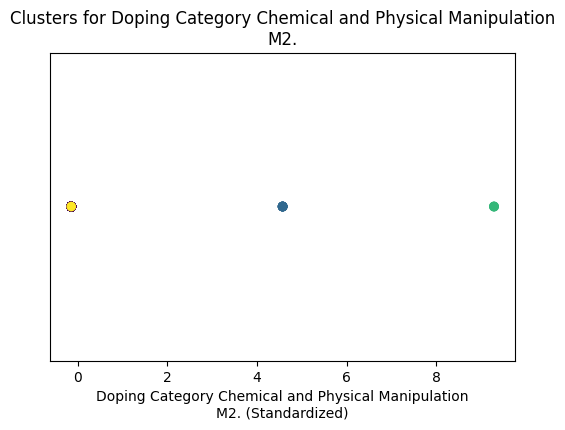

Clusters for Doping Category Chemical and Physical Manipulation
M2.:
  Cluster 0: ['Triathlon_2014', 'Triathlon_2015', 'Triathlon_2017', 'Triathlon_2018', 'Triathlon_2019', 'Triathlon_2020', 'Triathlon_2021', 'Triathlon_2022', 'Taekwondo_2014', 'Taekwondo_2015', 'Taekwondo_2016', 'Taekwondo_2017', 'Taekwondo_2018', 'Taekwondo_2019', 'Taekwondo_2020', 'Taekwondo_2021', 'Taekwondo_2022', 'Boules Sports_2014', 'Boules Sports_2015', 'Boules Sports_2016', 'Boules Sports_2017', 'Boules Sports_2018', 'Boules Sports_2019', 'Boules Sports_2020', 'Boules Sports_2021', 'Boules Sports_2022', 'Equestrian_2014', 'Equestrian_2015', 'Equestrian_2016', 'Equestrian_2017', 'Equestrian_2018', 'Equestrian_2019', 'Equestrian_2020', 'Equestrian_2021', 'Equestrian_2022', 'Athletics_2017', 'Athletics_2018', 'Athletics_2019', 'Athletics_2020', 'Athletics_2021', 'Athletics_2022', 'Judo_2014', 'Judo_2015', 'Judo_2016', 'Judo_2017', 'Judo_2018', 'Judo_2019', 'Judo_2020', 'Judo_2021', 'Judo_2022', 'Powerboating_201

In [14]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import numpy as np

# Number of clusters (adjust as needed)
n_clusters = 4

# Assuming desired_columns and sport_names_common are defined

# Iterate through doping categories
for category_index in range(len(desired_columns)):
    # Extract data for the current category
    category_data = X_common[:, category_index].reshape(-1, 1)

    # Standardize the data (optional but recommended)
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(category_data)

    # Perform Hierarchical Clustering
    hierarchical = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
    cluster_labels = hierarchical.fit_predict(scaled_data)

    # Visualize clusters
    plt.figure(figsize=(6, 4))
    plt.scatter(scaled_data[:, 0], np.zeros_like(scaled_data), c=cluster_labels)
    plt.title(f"Clusters for Doping Category {desired_columns[category_index]}")
    plt.xlabel(f"Doping Category {desired_columns[category_index]} (Standardized)")
    plt.yticks([])  # Hide y-axis ticks
    plt.show()

    # Print cluster assignments with included points
    print(f"Clusters for Doping Category {desired_columns[category_index]}:")
    for cluster_num in range(n_clusters):
        cluster_points = [sport_names_common[i] for i, label in enumerate(cluster_labels) if label == cluster_num]
        if cluster_points:  # Check if cluster has points
            print(f"  Cluster {cluster_num}: {cluster_points}")
        else:
            print(f"  Cluster {cluster_num}: (No points in this cluster)")
    print("\n")  # Add a newline for separation

For each doping category (e.g., Anabolic Agents, Peptide Hormones, etc.), hierarchical clustering is performed across all (sport, year) entries based solely on their standardized values for that specific substance. This method reveals which sports exhibit similar patterns for each type of doping agent, independently of their overall anti-doping profiles.

For each doping method, a color-coded scatter plot of standardized values is generated to visualize how sports are grouped into clusters. Additionally, a list of sports and years belonging to each cluster is provided, highlighting which sports share similar substance use patterns.

This granular, per-category clustering approach identifies specific similarities and anomalies in doping patterns that may not be apparent in a global or multi-variable analysis.

# Migration Analysis

### Sports That Change Clusters (Migrators)
Tracks and lists sports whose cluster membership changes across years—potential indicators of evolving doping patterns.


In [15]:
import pandas as pd

# 1) Build a DataFrame of sport, year, and cluster
records = []
for name, label in zip(sport_names, hierarchical_labels):
    sport, year = name.rsplit('_', 1)        # split “SportName_YYYY”
    records.append({
        'sport': sport,
        'year': int(year),
        'cluster': int(label)
    })
df = pd.DataFrame(records)

# 2) Pivot so each row is a sport and each column is a year
pivot = df.pivot(index='sport', columns='year', values='cluster').sort_index()

# 3) Show the result
print("Cluster membership over time:\n", pivot)

# 4) Find sports that ever change cluster
migrators = pivot[pivot.nunique(axis=1) > 1].index.tolist()
print("\nSports that migrate between clusters:", migrators)


Cluster membership over time:
 year               2014  2015  2016  2017  2018  2019  2020  2021  2022
sport                                                                  
American Football     3     3     1     3     1     3     3     3     3
Aquatics              1     1     1     1     1     1     3     1     1
Archery               3     3     3     3     3     3     3     3     3
Arm Wrestling         1     1     3     3     1     3     3     3     1
Athletics             2     2     2     2     2     2     1     2     2
Badminton             3     3     3     3     3     3     3     3     3
Basketball            3     1     3     3     3     3     3     3     3
Biathlon              3     3     3     3     3     3     3     3     3
Bodybuilding          0     0     0     0     0     0     2     2     2
Boules Sports         3     3     3     3     3     3     3     3     3
Boxing                1     1     1     1     1     1     3     3     1
Cricket               3     3    

### Cluster Membership Heatmap (Migrators Only)
For sports that migrate between clusters, creates a heatmap showing cluster assignment by year. Highlights dynamic shifts in anti-doping profiles over time.


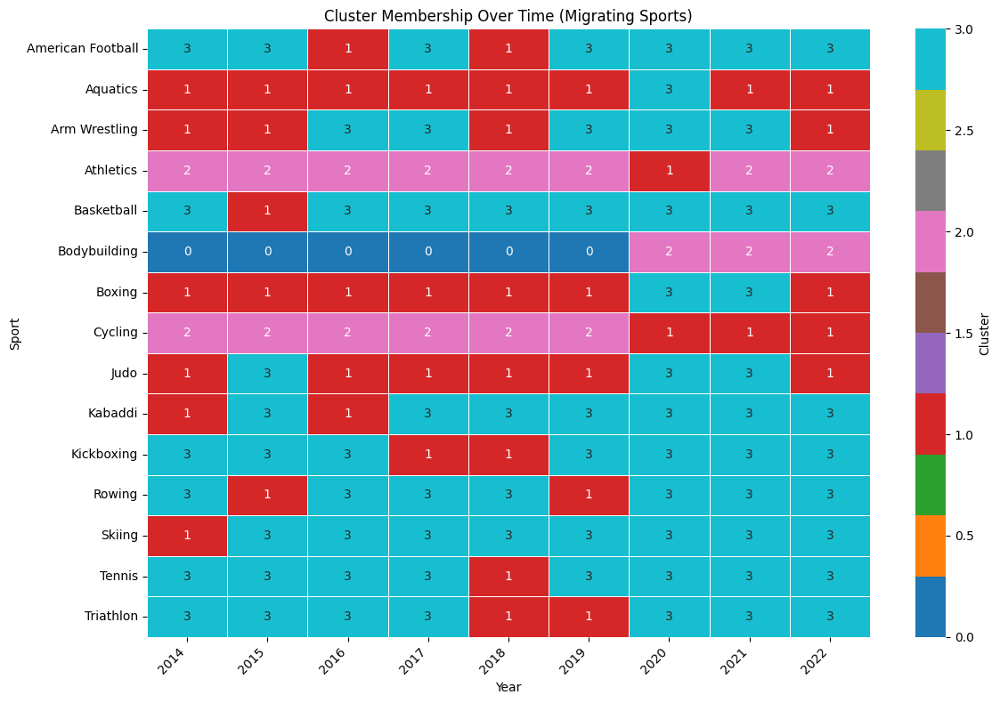

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import AgglomerativeClustering  # Import AgglomerativeClustering

# Perform hierarchical clustering (if not already done)
n_clusters = 4  # Define the number of clusters
hierarchical = AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')
hierarchical_labels = hierarchical.fit_predict(X_common)  # Get cluster labels

# --- 1) Rebuild the full df of (sport, year, cluster) ---
records = []
for name, label in zip(sport_names, hierarchical_labels):
    sport, year = name.rsplit('_', 1)
    records.append({'sport': sport, 'year': int(year), 'cluster': int(label)})
df = pd.DataFrame(records)

# --- 2) Filter to sports that change clusters (regardless of year) ---

sports_to_plot = df.groupby('sport')['cluster'].apply(lambda x: x.nunique() > 1).index[df.groupby('sport')['cluster'].apply(lambda x: x.nunique() > 1).values].tolist()  # Get sports that change clusters
df_mig = df[df['sport'].isin(sports_to_plot)]  # Filter the DataFrame

# --- 3) Pivot into a wide table ---
pivot_mig = df_mig.pivot(index='sport', columns='year', values='cluster') \
                  .sort_index(axis=0) \
                  .sort_index(axis=1)

# --- 4) Ensure numeric and no missing values ---
pivot_mig = pivot_mig.fillna(-1).astype(int)  # Moved this line up

# --- 5) Error handling and plotting ---
if pivot_mig.empty:
    print("No sports found that change clusters. Cannot create heatmap.")
elif pivot_mig.isnull().all().all():  # Check after filling NaNs
    print("All values in the pivoted DataFrame are NaN. Cannot create heatmap.")
else:
    # Proceed with plotting using sns.heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(pivot_mig, annot=True, fmt="d", cmap="tab10",
                cbar_kws={"label": "Cluster"}, linewidths=0.5)
    plt.title("Cluster Membership Over Time (Migrating Sports)")
    plt.xlabel("Year")
    plt.ylabel("Sport")
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

# Permutation Feature Importance for Clustering

Permutation Feature Importances for Cluster Prediction:
Anabolic Agents\nS1.                                            0.252818
Diuretics and Other Masking Agents\nS5.                         0.012319
Stimulants\nS6.                                                 0.008374
Hormone and Metabolic Modulators\nS4.                           0.003382
Peptide Hormones, Growth Factors and Related Substances\nS2.    0.002013
Beta‐2 Agonists\nS3.                                            0.000000
Narcotics\nS7.                                                  0.000000
Cannabinoids\nS8.                                               0.000000
Glucocortico‐steroids\nS9.                                      0.000000
Beta-Blockers\nP1.                                              0.000000
Enhancement of Oxygen Transfer\nM1.                             0.000000
Chemical and Physical Manipulation\nM2.                         0.000000
dtype: float64


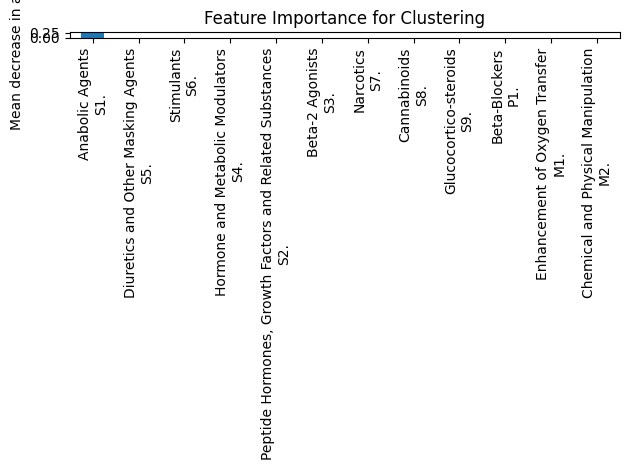

In [28]:
from sklearn.inspection import permutation_importance
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import pandas as pd

def cluster_importance(X, labels, feature_names):
    # Train classifier to predict cluster labels from features
    clf = RandomForestClassifier(n_estimators=100, random_state=42)
    clf.fit(X, labels)

    # Compute permutation importance
    result = permutation_importance(clf, X, labels, n_repeats=30, random_state=42)

    # Create a Pandas Series for better display and sorting
    importances = pd.Series(result.importances_mean, index=feature_names)
    importances = importances.sort_values(ascending=False)

    print("Permutation Feature Importances for Cluster Prediction:")
    print(importances)

    # Plot
    importances.plot.bar()
    plt.title("Feature Importance for Clustering")
    plt.ylabel("Mean decrease in accuracy")
    plt.tight_layout()
    plt.show()

# You have these variables in your project:
# X = numpy array of features for clustering (already padded)
# kmeans_labels = cluster labels from KMeans clustering
# desired_columns = list of feature names (doping substance categories)

# Since X may have more columns due to padding, repeat feature names accordingly
repeated_feature_names = desired_columns * (X.shape[1] // len(desired_columns))

# Call the function
cluster_importance(X, kmeans_labels, repeated_feature_names)




# forecasting for substances depending on year and sport

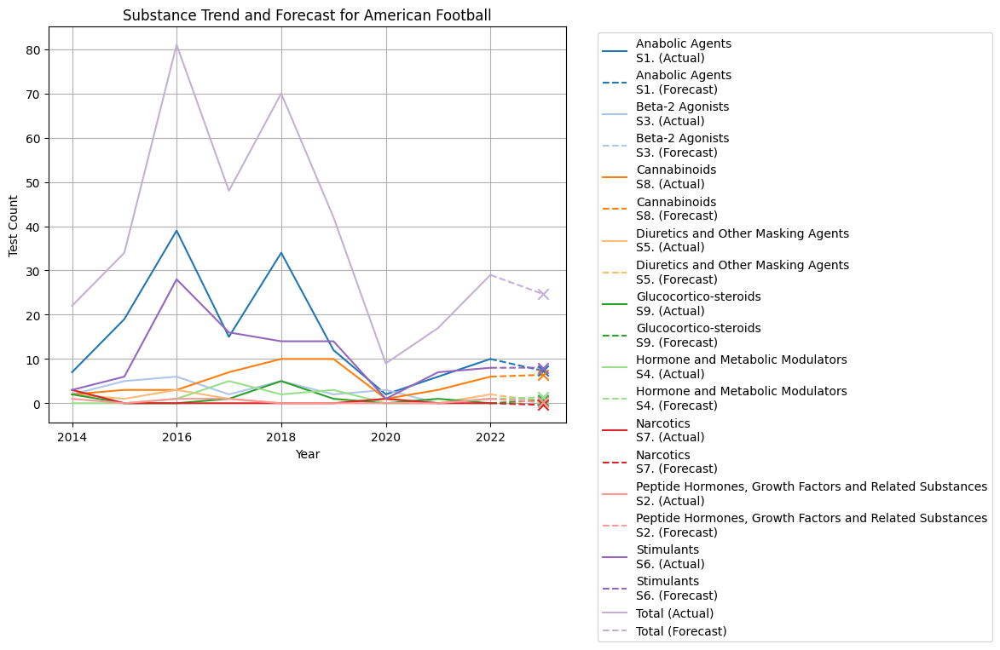

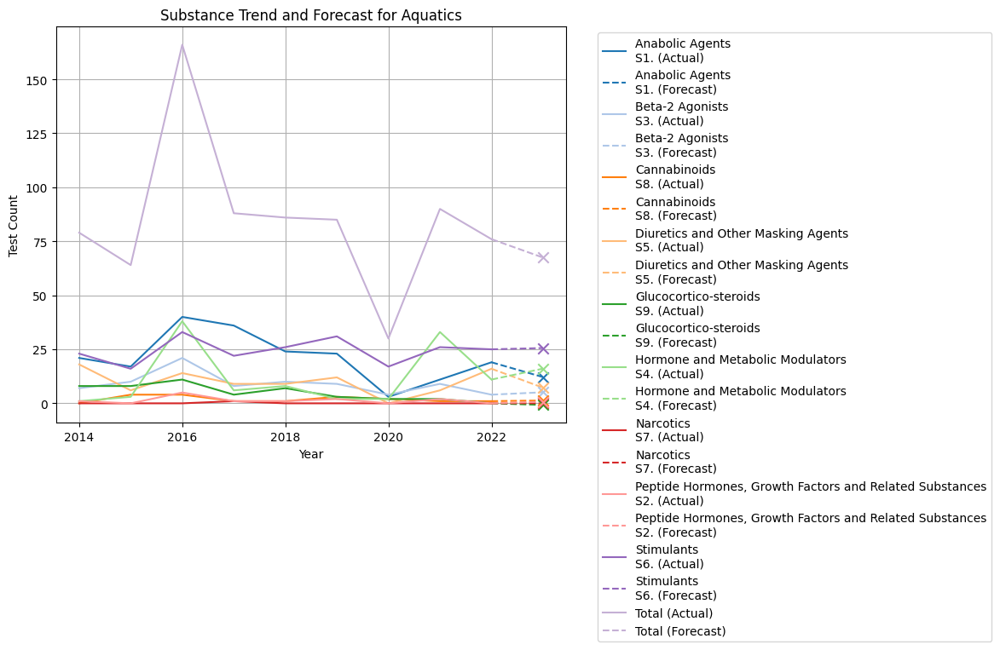

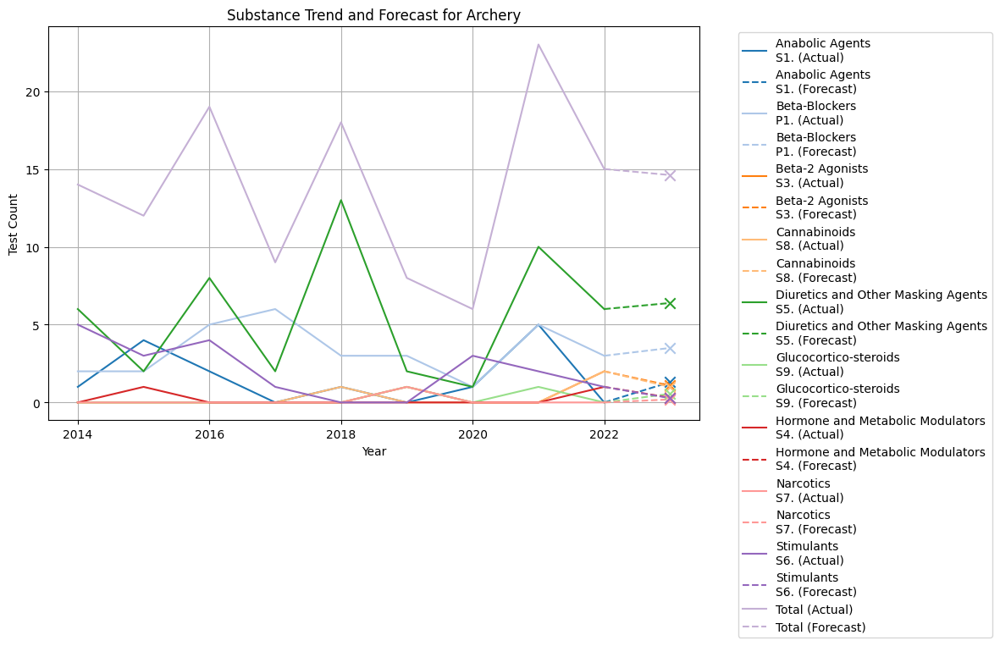

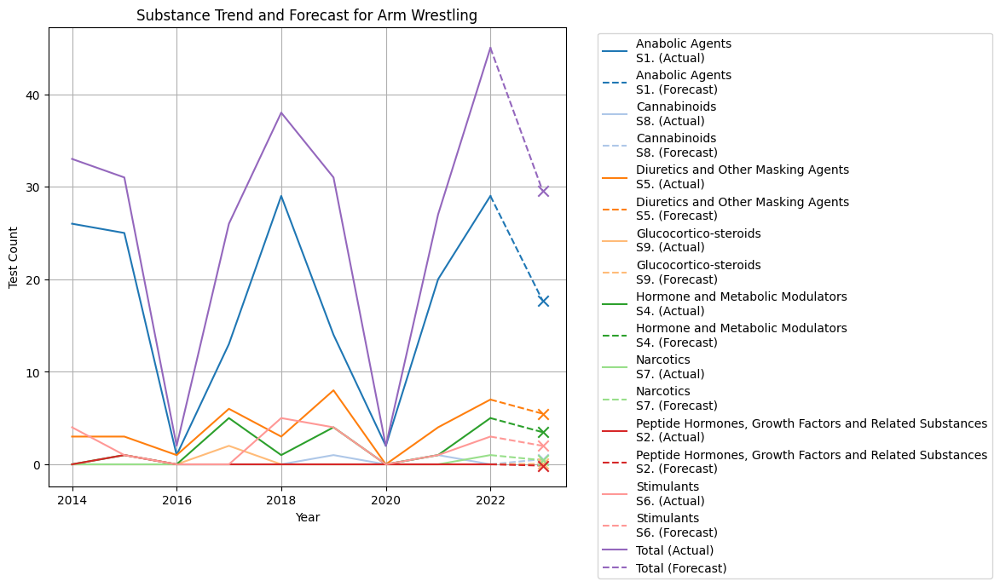

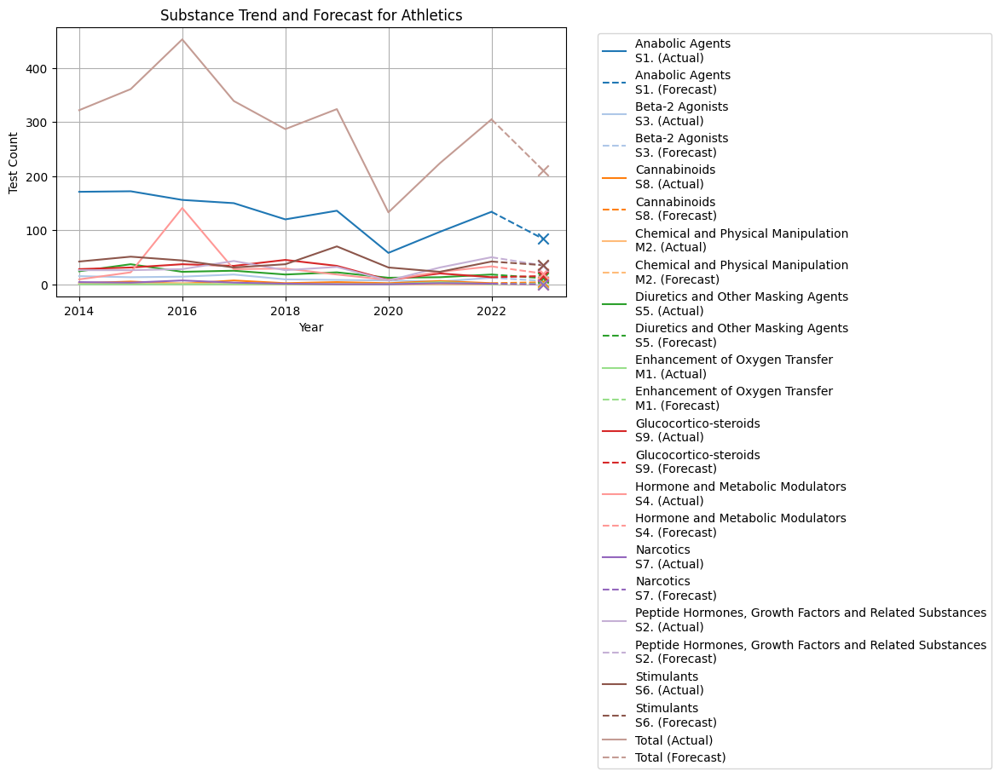

...

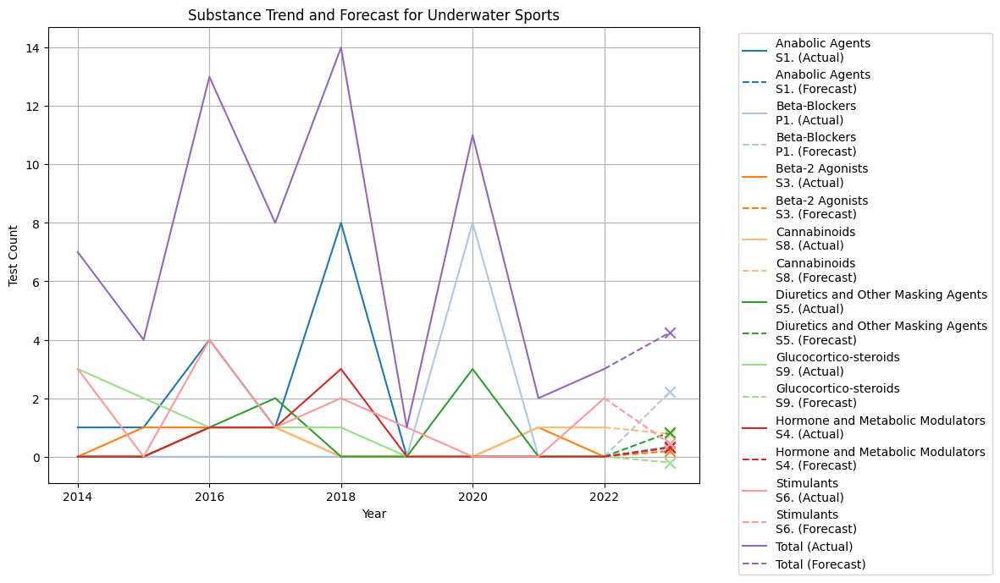

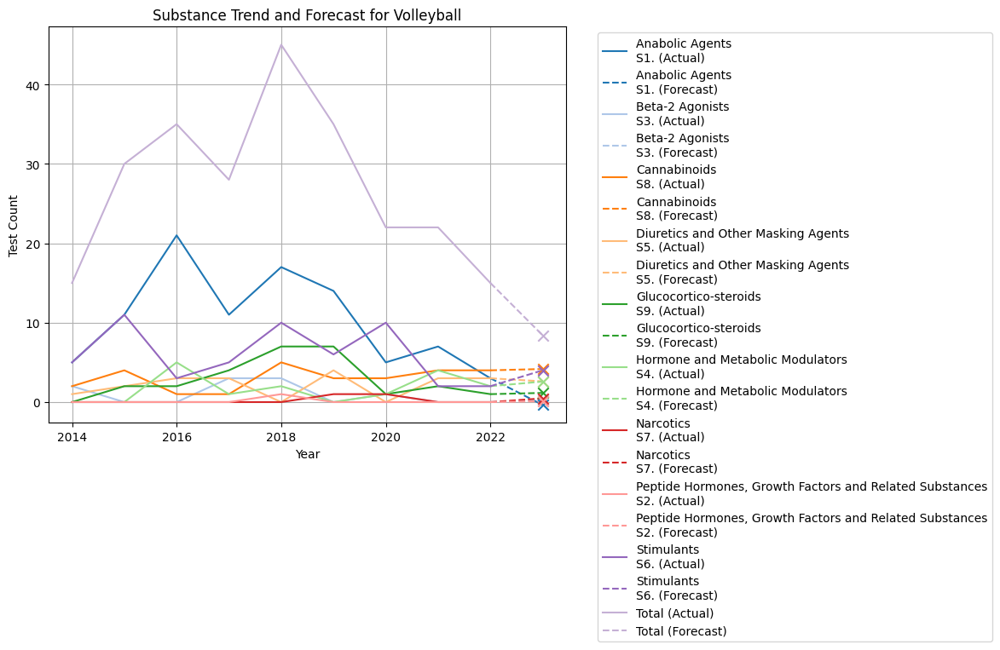

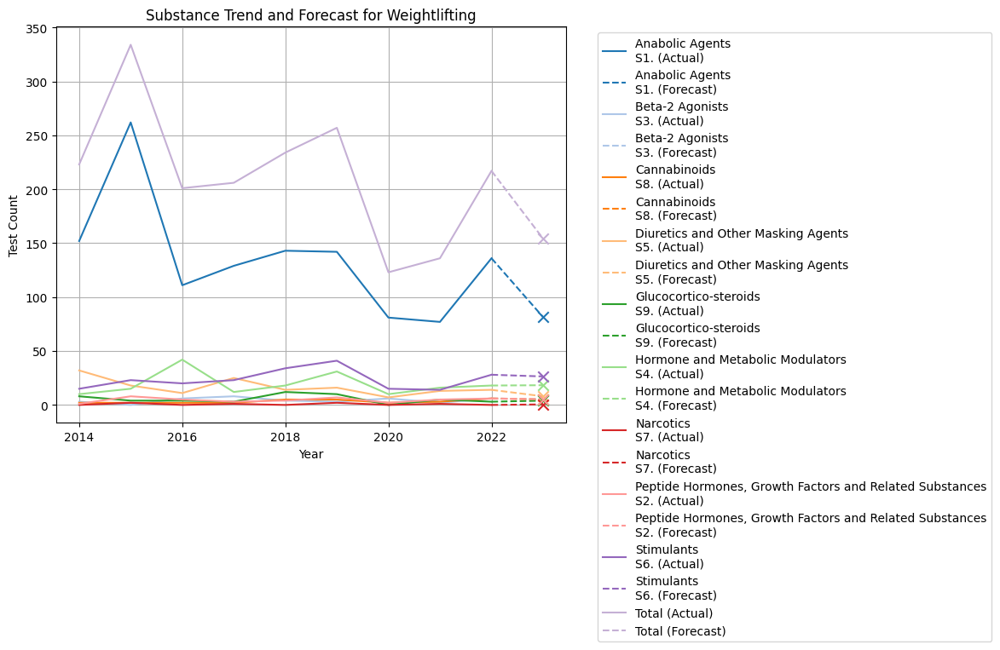

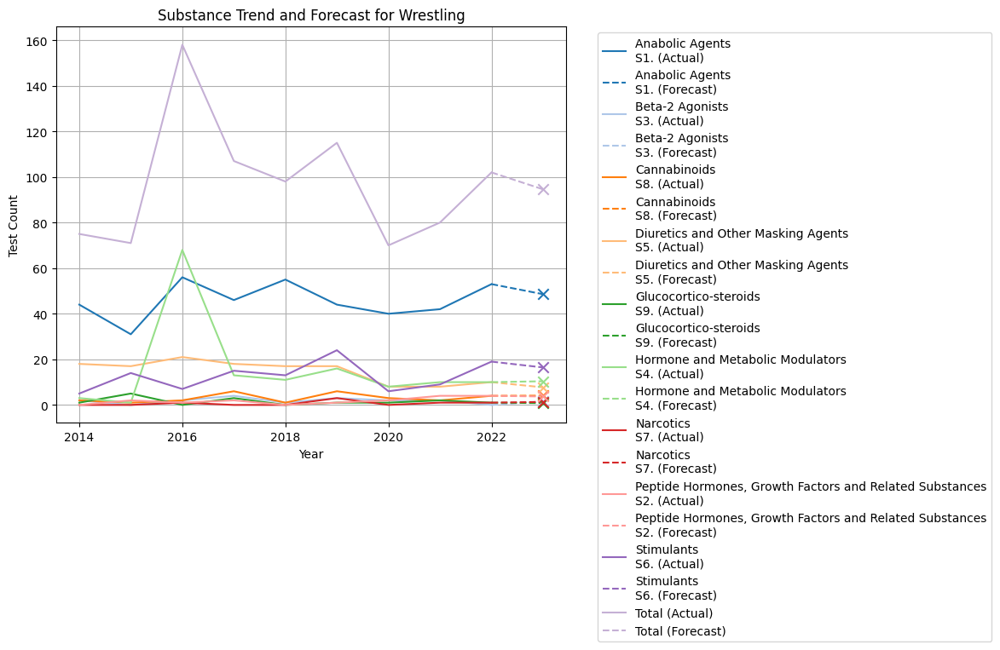

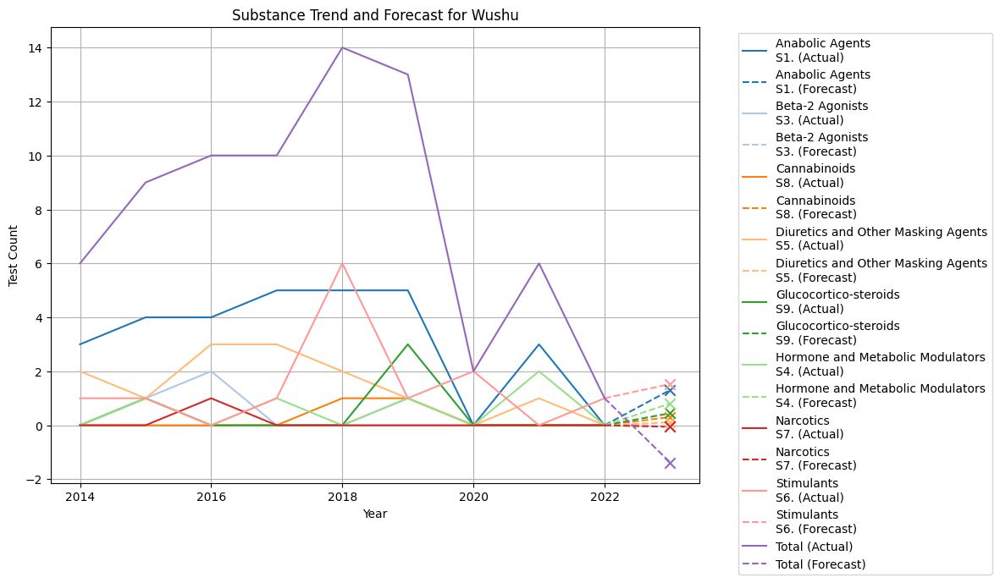

In [17]:
import matplotlib.pyplot as plt
import numpy as np
from statsmodels.tsa.holtwinters import ExponentialSmoothing
import pandas as pd

# Build long-form dataframe from tables
df_long_list = []

for year, df in tables.items():
    year_int = int(year)
    sport_col = df.columns[0]
    for row in df.itertuples(index=False, name=None):  # now row is a tuple, not a namedtuple
        sport = row[0]  # sport is always the first column
        for i, substance in enumerate(df.columns[1:], 1):  # start at index 1
            count = row[i]
            df_long_list.append({
                'Sport': sport,
                'Year': year_int,
                'Substance': substance,
                'Count': count
            })

df_long = pd.DataFrame(df_long_list)

# For each sport, plot all its substances
for chosen_sport in sorted(common_sports):
    df_forecast = []
    substances = sorted(df_long[df_long['Sport'] == chosen_sport]['Substance'].unique())
    for substance in substances:
        ts = df_long[(df_long['Sport'] == chosen_sport) & (df_long['Substance'] == substance)].sort_values('Year')
        if len(ts) < 4 or ts['Count'].sum() == 0:
            continue
        y = ts['Count'].values
        x = ts['Year'].values
        try:
            model = ExponentialSmoothing(y, trend='add', seasonal=None, initialization_method="estimated").fit()
            y_pred = model.fittedvalues
            y_forecast = model.forecast(1)
        except Exception as e:
            print(f"Skipping {chosen_sport}-{substance}: {e}")
            continue
        pred_years = list(x) + [x[-1] + 1]
        preds = np.concatenate([y_pred, y_forecast])
        actual = list(y) + [np.nan]
        df_sub = pd.DataFrame({
            'Year': pred_years,
            'Actual': actual,
            'Forecast': preds,
            'IsForecast': [False]*len(y_pred) + [True]
        })
        df_sub['Substance'] = substance
        df_forecast.append(df_sub)
    if not df_forecast:
        continue
    df_forecast = pd.concat(df_forecast, ignore_index=True)

    # PLOT
    plt.figure(figsize=(12, 7))
    color_cycle = plt.cm.tab20.colors
    for idx, substance in enumerate(df_forecast['Substance'].unique()):
        df_sub = df_forecast[df_forecast['Substance'] == substance]
        c = color_cycle[idx % len(color_cycle)]
        # Plot actual
        actual = df_sub[~df_sub['IsForecast']]
        plt.plot(actual['Year'], actual['Actual'], label=f"{substance} (Actual)", color=c)
        # Plot forecast (last point, dashed line from last actual)
        forecast = df_sub[df_sub['IsForecast']]
        if not forecast.empty:
            plt.plot(
                [actual['Year'].values[-1], forecast['Year'].values[0]],
                [actual['Actual'].values[-1], forecast['Forecast'].values[0]],
                '--', color=c, label=f"{substance} (Forecast)"
            )
            plt.scatter(forecast['Year'], forecast['Forecast'], color=c, marker='x', s=80, zorder=10)

    plt.title(f"Substance Trend and Forecast for {chosen_sport}")
    plt.xlabel("Year")
    plt.ylabel("Test Count")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.grid(True)
    plt.show()




In [18]:
from IPython.display import display, Markdown
from statsmodels.tsa.holtwinters import ExponentialSmoothing
import matplotlib.pyplot as plt
import numpy as np

forecast_horizon = 1
future_forecasts = []

for substance in sorted(df_long['Substance'].unique()):
    for sport in sorted(common_sports):  # <-- restrict to common_sports
        ts = df_long[(df_long['Sport'] == sport) & (df_long['Substance'] == substance)].sort_values('Year')
        if len(ts) < 4 or ts['Count'].sum() == 0:
            continue
        y = ts['Count'].values
        x = ts['Year'].values
        try:
            model = ExponentialSmoothing(y, trend='add', seasonal=None, initialization_method="estimated").fit()
            y_pred = model.fittedvalues
            y_forecast = model.forecast(forecast_horizon)
        except Exception as e:
            print(f"Skipping {sport}-{substance}: {e}")
            continue
        pred_years = list(x) + [x[-1] + i + 1 for i in range(forecast_horizon)]
        preds = np.concatenate([y_pred, y_forecast])
        forecast_rows = pd.DataFrame({
            'Sport': sport,
            'Substance': substance,
            'Year': pred_years,
            'Forecast_Count': preds
        })
        future_forecasts.append(forecast_rows)

df_forecast = pd.concat(future_forecasts, ignore_index=True)

next_year = df_long['Year'].max() + 1
df_next = df_forecast[df_forecast['Year'] == next_year]

# Pivot: rows = sports, columns = substances, values = forecasted count
pivot_next = df_next.pivot(index='Sport', columns='Substance', values='Forecast_Count')

# Notebook-friendly output:
pivot_next_clean = pivot_next.round(2).fillna('')

display(Markdown(f"### Forecasted Substance Counts for {next_year} (Common Sports)"))
display(pivot_next_clean)

### Forecasted Substance Counts for 2023 (Common Sports)

Substance,Anabolic Agents\nS1.,Beta-Blockers\nP1.,Beta‐2 Agonists\nS3.,Cannabinoids\nS8.,Chemical and Physical Manipulation\nM2.,Diuretics and Other Masking Agents\nS5.,Enhancement of Oxygen Transfer\nM1.,Glucocortico‐steroids\nS9.,Hormone and Metabolic Modulators\nS4.,Narcotics\nS7.,"Peptide Hormones, Growth Factors and Related Substances\nS2.",Stimulants\nS6.,Total
Sport,,,,,,,,,,,,,
American Football,7.33,,0.81,6.41,,0.44,,0.69,1.33,-0.39,0.19,8.03,24.69
Aquatics,12.14,,5.11,1.31,,7.25,,-0.75,16.06,0.03,0.75,25.58,67.47
Archery,1.31,3.5,1.08,1.0,,6.39,,0.56,0.31,0.19,,0.28,14.61
Arm Wrestling,17.67,,,0.56,,5.47,,0.06,3.47,0.44,-0.14,2.00,29.53
Athletics,84.08,,6.22,3.61,-0.47,11.25,1.44,15.19,19.81,-0.33,34.72,35.31,210.87
Badminton,0.94,,-0.08,-0.17,,3.08,,-0.17,2.0,1.0,,1.03,7.64
Basketball,3.11,,-0.12,16.0,0.44,3.87,,3.17,3.47,0.42,1.03,26.00,32.86
Biathlon,-0.5,,0.64,,,0.36,,0.0,0.89,,-0.08,0.14,0.97
Bodybuilding,99.08,,1.31,3.12,,82.39,,1.19,43.36,-0.0,1.75,9.08,130.19


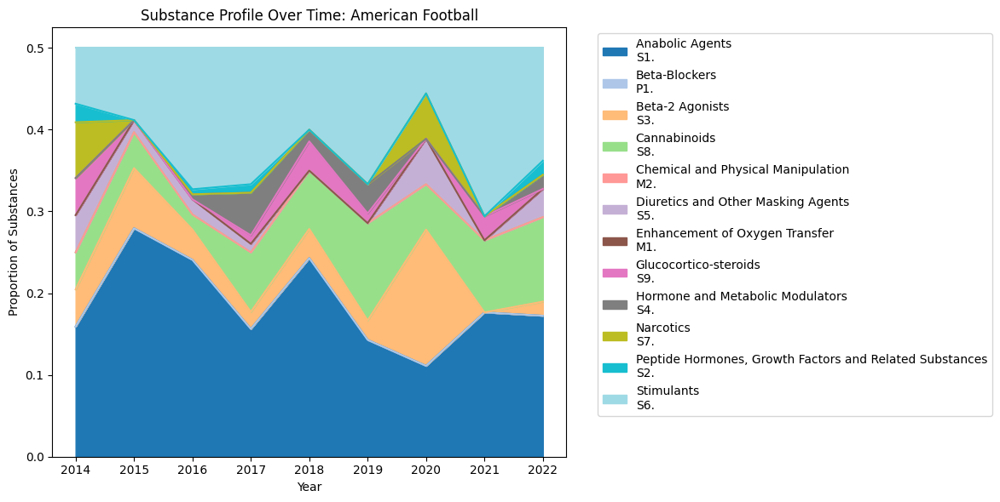

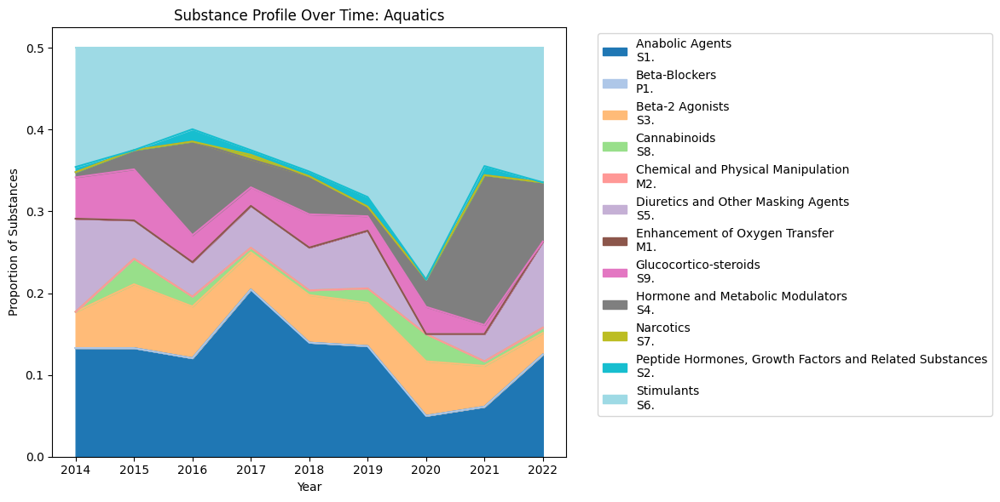

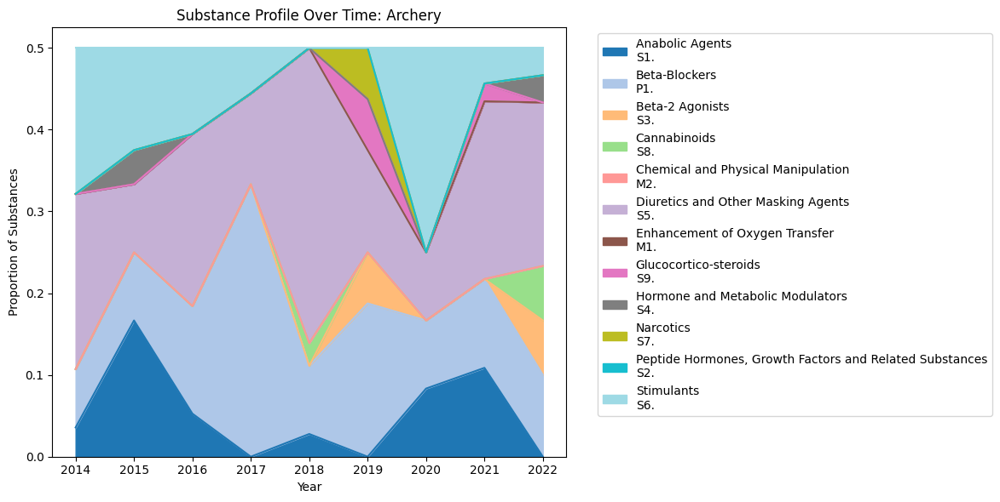

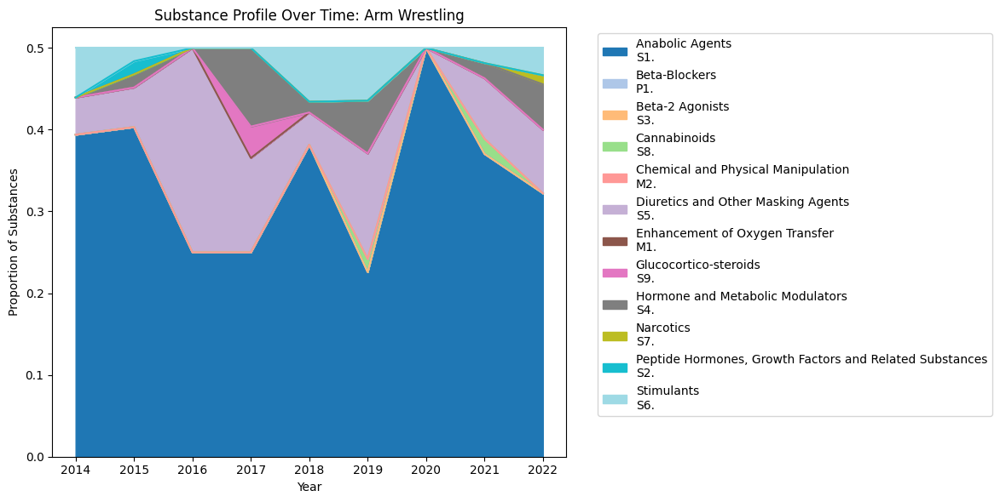

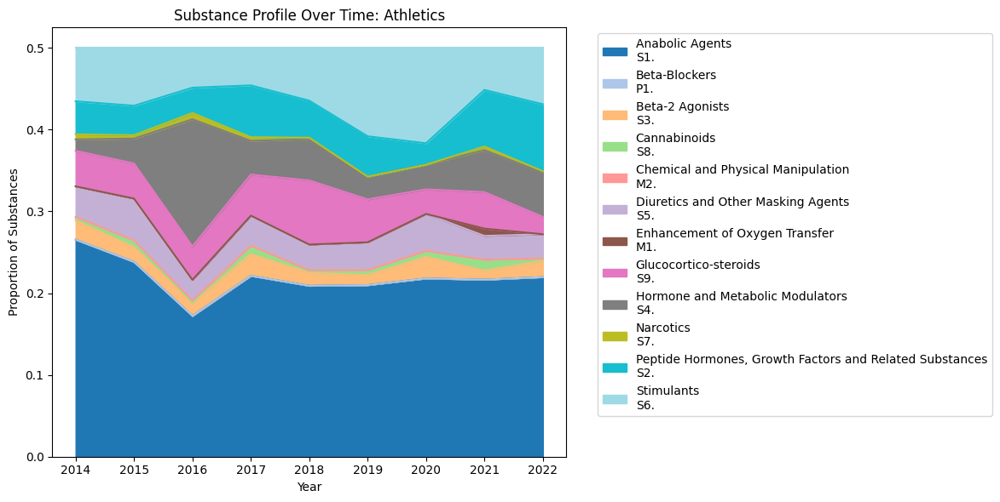

...

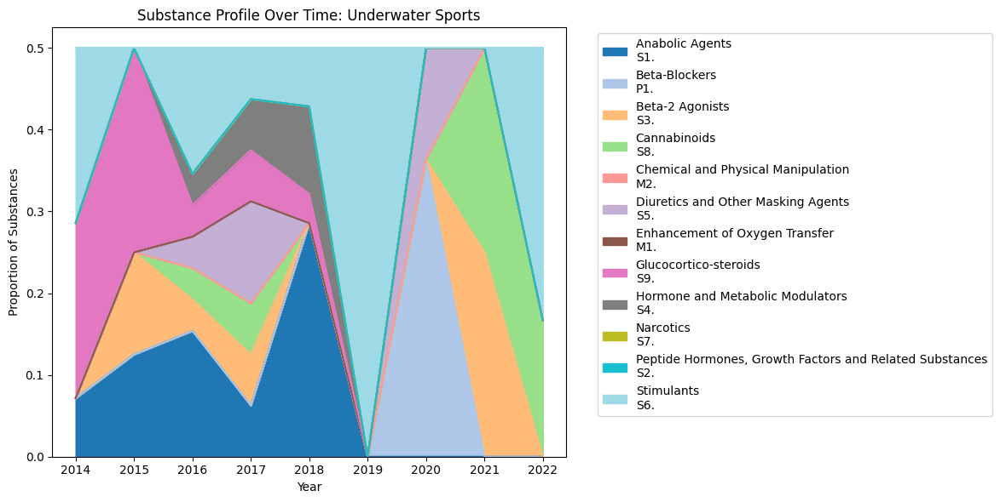

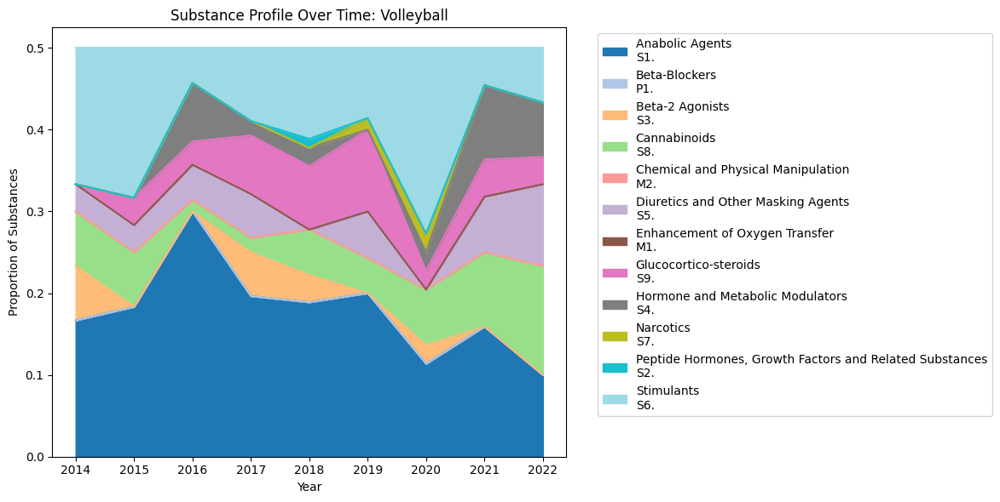

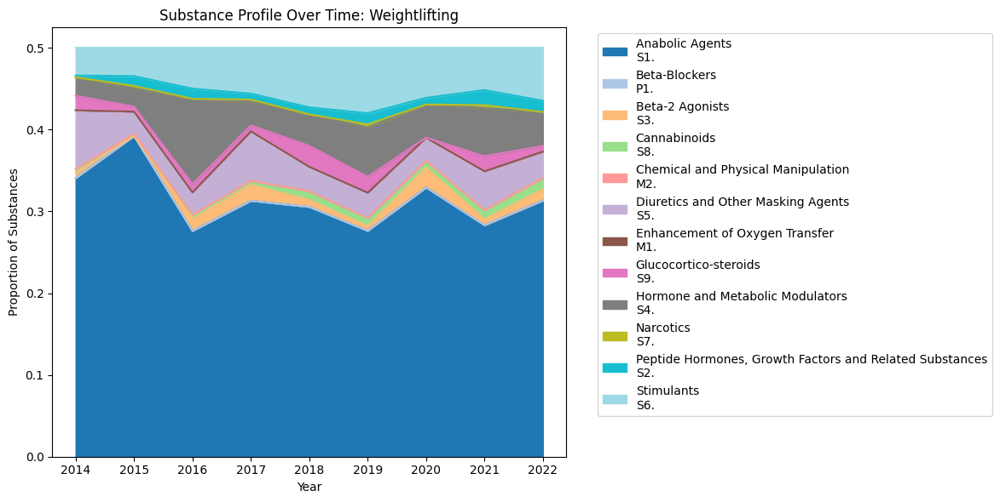

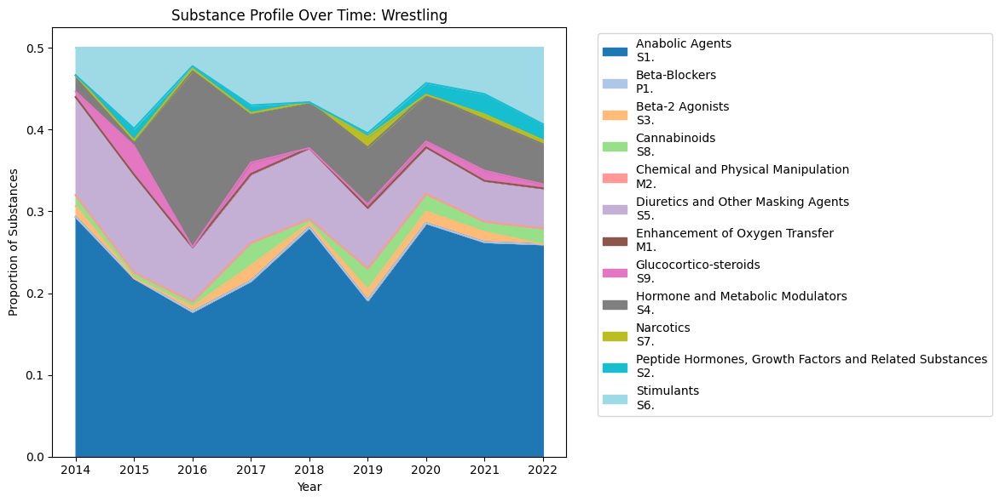

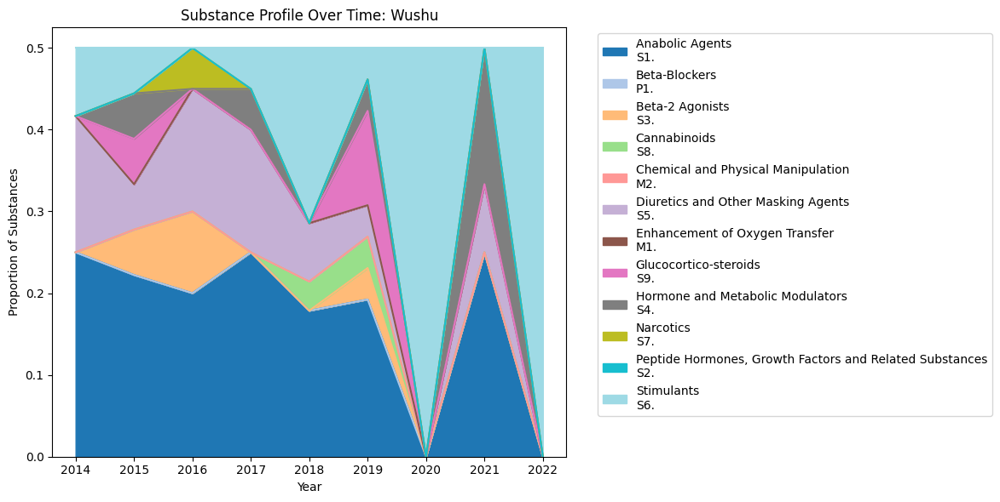

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial.distance import cosine

yearly_changes = []

for chosen_sport in sorted(common_sports):
    df_sport = df_long[df_long['Sport'] == chosen_sport]
    if df_sport.empty:
        continue

    pivot = df_sport.pivot_table(index='Year', columns='Substance', values='Count', fill_value=0)
    pivot_norm = pivot.div(pivot.sum(axis=1), axis=0)

    # --- Exclude the last column for plotting and similarity ---
    if pivot_norm.shape[1] > 1:
        pivot_norm = pivot_norm.iloc[:, :-1]

    years = list(pivot_norm.index)
    for i in range(1, len(years)):
        y_prev = years[i-1]
        y_curr = years[i]
        v_prev = pivot_norm.loc[y_prev].reindex(pivot_norm.columns, fill_value=0).values
        v_curr = pivot_norm.loc[y_curr].reindex(pivot_norm.columns, fill_value=0).values
        similarity = 1 - cosine(v_prev, v_curr)
        distance = cosine(v_prev, v_curr)
        yearly_changes.append({
            'Sport': chosen_sport,
            'Year1': y_prev,
            'Year2': y_curr,
            'Cosine Similarity': similarity,
            'Cosine Distance': distance
        })

    # Plot normalized area plot for each sport (without last column)
    if pivot_norm.shape[1] > 1:
        pivot_norm.plot.area(figsize=(12, 6), cmap='tab20')
        plt.title(f"Substance Profile Over Time: {chosen_sport}")
        plt.ylabel("Proportion of Substances")
        plt.xlabel("Year")
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        plt.show()

# Convert results to DataFrame for later analysis
changes_df = pd.DataFrame(yearly_changes)


In [20]:
import pandas as pd
from scipy.spatial.distance import cosine
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display, clear_output

# Precompute yearly cosine similarities for all sports
yearly_changes = []

for chosen_sport in sorted(common_sports):
    df_sport = df_long[df_long['Sport'] == chosen_sport]
    if df_sport.empty:
        continue

    pivot = df_sport.pivot_table(index='Year', columns='Substance', values='Count', fill_value=0)
    pivot_norm = pivot.div(pivot.sum(axis=1), axis=0)
    years = list(pivot_norm.index)
    for i in range(1, len(years)):
        y_prev = years[i-1]
        y_curr = years[i]
        v_prev = pivot_norm.loc[y_prev].reindex(pivot_norm.columns, fill_value=0).values
        v_curr = pivot_norm.loc[y_curr].reindex(pivot_norm.columns, fill_value=0).values
        similarity = 1 - cosine(v_prev, v_curr)
        distance = cosine(v_prev, v_curr)
        yearly_changes.append({
            'Sport': chosen_sport,
            'Year1': y_prev,
            'Year2': y_curr,
            'Cosine Similarity': similarity,
            'Cosine Distance': distance
        })

changes_df = pd.DataFrame(yearly_changes)

# ---- Interactive plot ----

def plot_similarity(selected_sport):
    df_plot = changes_df[changes_df['Sport'] == selected_sport]
    if df_plot.empty:
        print("No data for this sport.")
        return
    plt.figure(figsize=(10, 5))
    plt.plot(df_plot['Year2'], df_plot['Cosine Similarity'], marker='o')
    plt.title(f"Year-to-Year Cosine Similarity for {selected_sport}")
    plt.xlabel("Year")
    plt.ylabel("Cosine Similarity (vs previous year)")
    plt.ylim(0, 1.05)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Create a dropdown toggle for sports
sport_dropdown = widgets.Dropdown(
    options=sorted(changes_df['Sport'].unique()),
    value=sorted(changes_df['Sport'].unique())[0],
    description='Sport:',
    style={'description_width': 'initial'},
    layout=widgets.Layout(width='350px')
)

widgets.interact(plot_similarity, selected_sport=sport_dropdown)



interactive(children=(Dropdown(description='Sport:', layout=Layout(width='350px'), options=('American Football…

<function __main__.plot_similarity(selected_sport)>

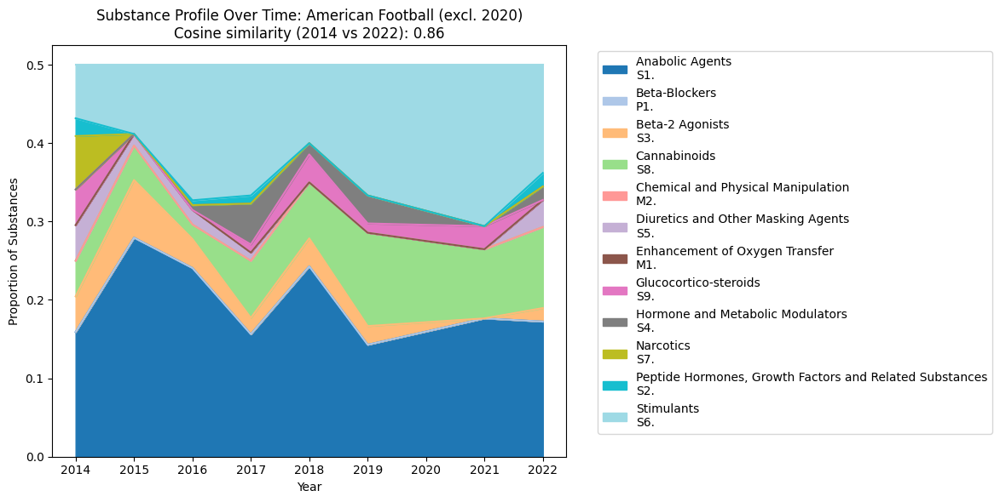

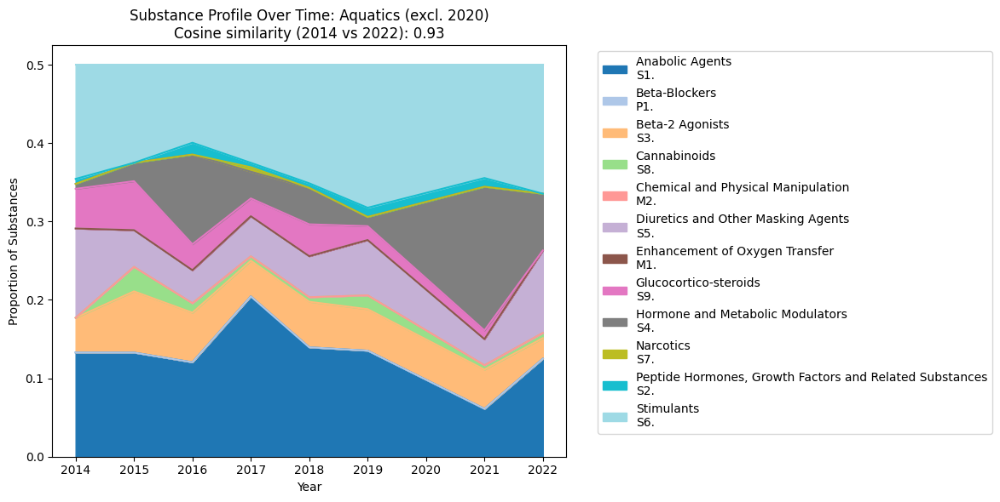

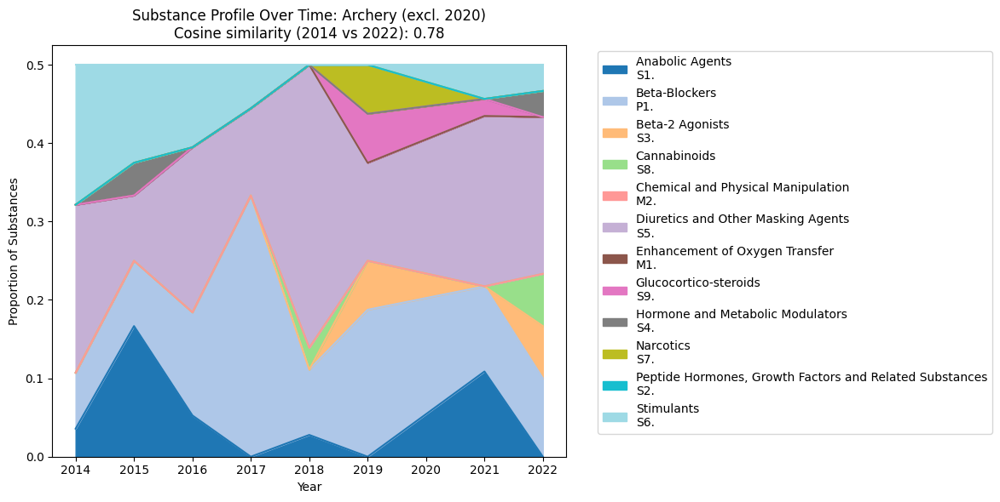

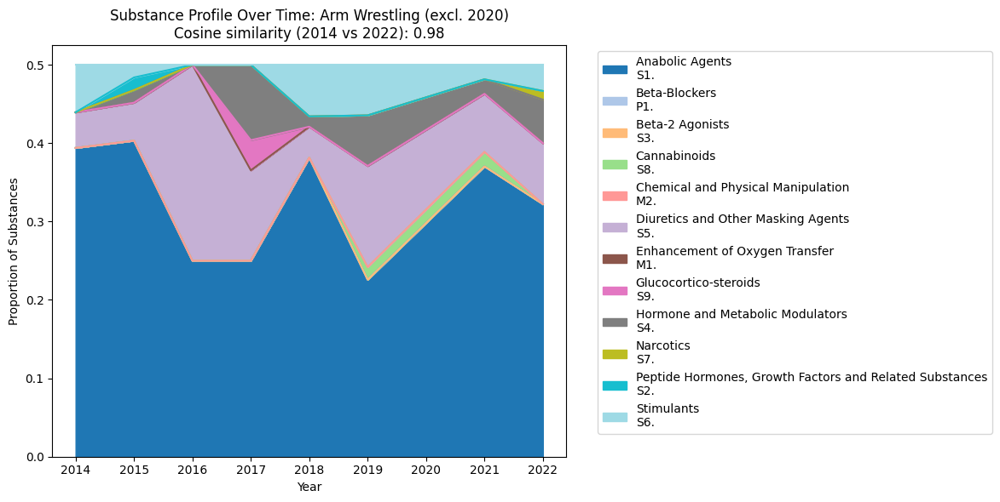

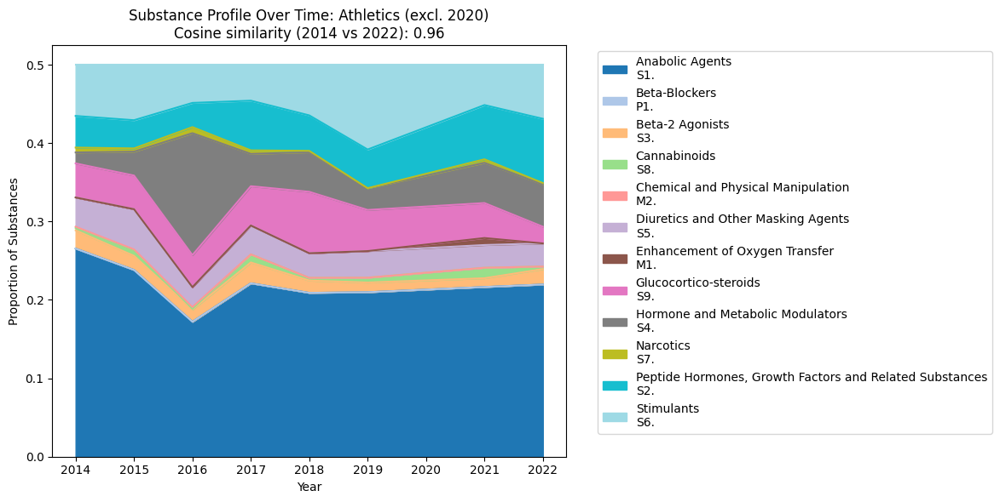

...

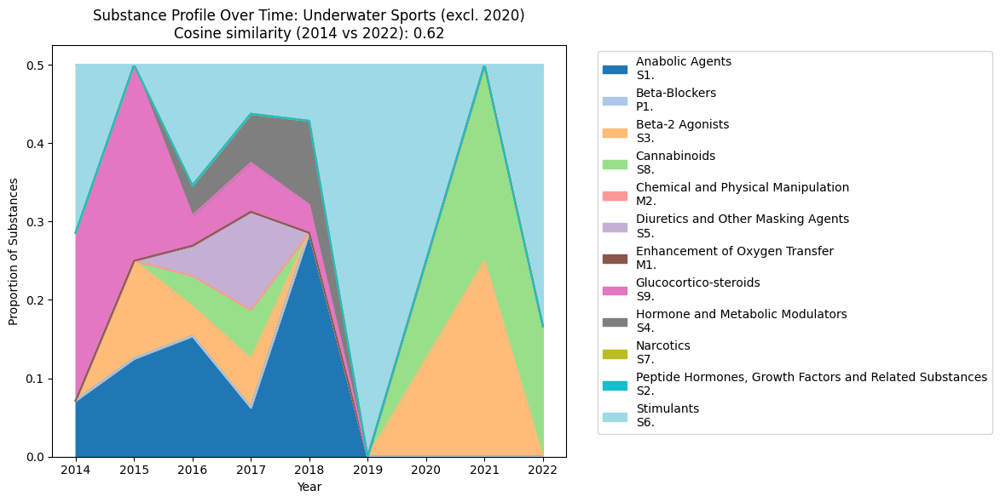

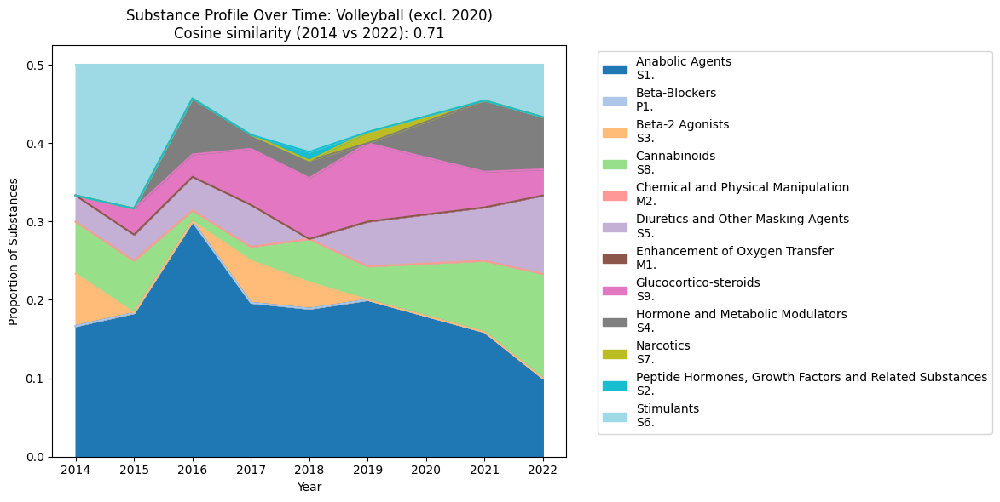

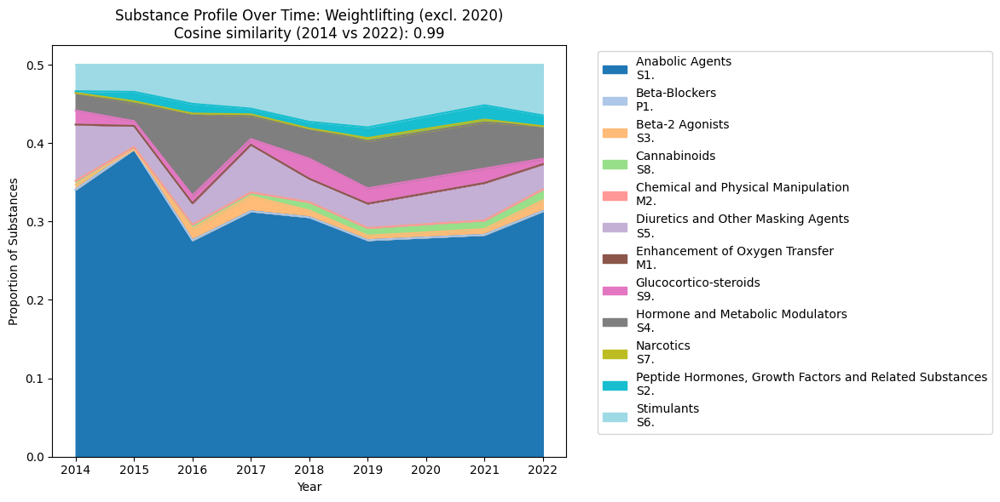

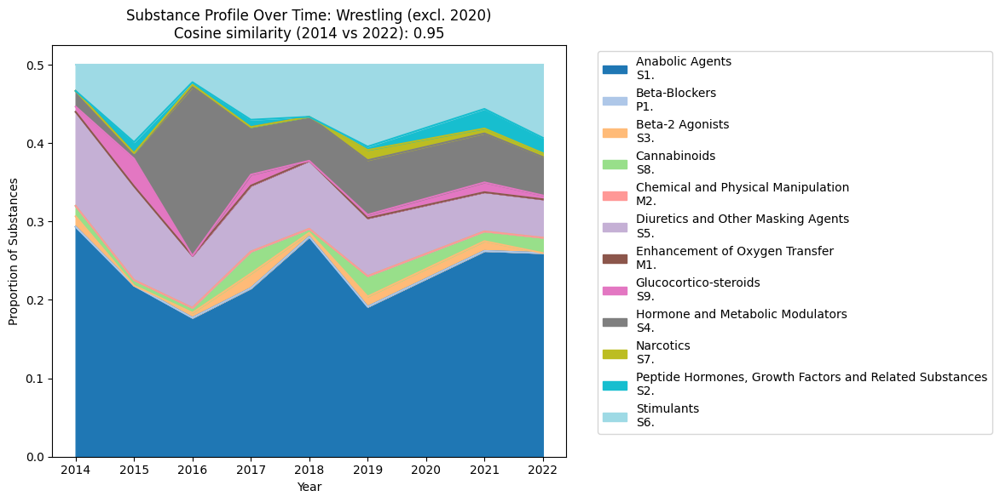

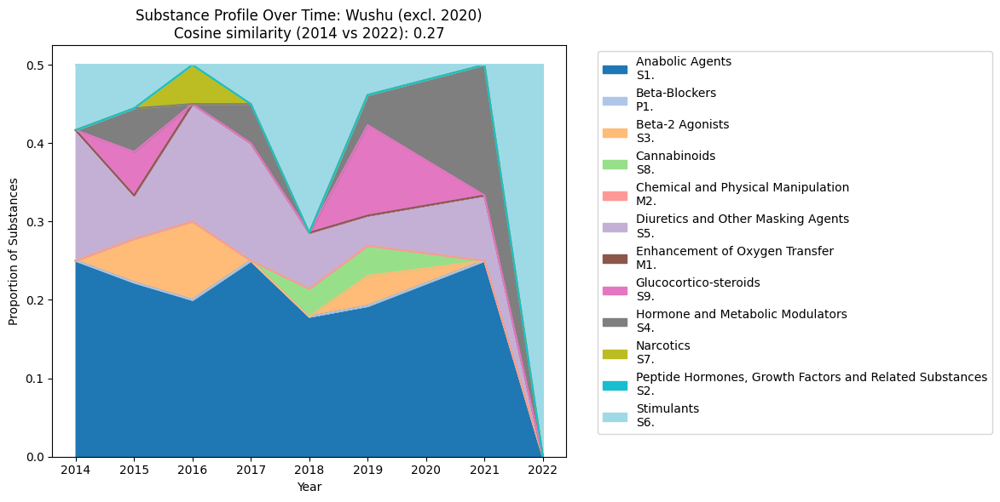

                Sport  Year Start  Year End  Cosine Similarity  \
7            Biathlon        2014      2022           0.000000   
5           Badminton        2014      2022           0.000000   
11            Cricket        2014      2022           0.000000   
16          Floorball        2014      2022           0.000000   
28       Powerboating        2014      2022           0.000000   
36             Squash        2014      2022           0.000000   
9       Boules Sports        2014      2022           0.258199   
45              Wushu        2014      2022           0.267261   
34            Skating        2014      2022           0.444478   
19               Golf        2014      2022           0.476290   
20         Gymnastics        2014      2022           0.516398   
35             Skiing        2014      2022           0.574737   
30      Roller Sports        2014      2022           0.598312   
41  Underwater Sports        2014      2022           0.615587   
33        

In [21]:
import matplotlib.pyplot as plt
import pandas as pd
from scipy.spatial.distance import cosine

results = []

for chosen_sport in sorted(common_sports):
    # Exclude 2020
    df_sport = df_long[(df_long['Sport'] == chosen_sport) & (df_long['Year'] != 2020)]
    if df_sport.empty:
        continue

    # Build pivot table
    pivot = df_sport.pivot_table(index='Year', columns='Substance', values='Count', fill_value=0)
    pivot_norm = pivot.div(pivot.sum(axis=1), axis=0)

    # Exclude the last column (e.g., "Total" or any last substance column)
    if pivot_norm.shape[1] > 1:
        pivot_norm = pivot_norm.iloc[:, :-1]

    # Only if more than one substance and nonzero
    if pivot_norm.shape[1] > 1 and pivot_norm.sum().sum() > 0:
        # Get first and last year rows
        profile_early = pivot_norm.iloc[0].values
        profile_late = pivot_norm.iloc[-1].values

        # Re-align columns (in case substance columns differ between years)
        profile_early = pivot_norm.iloc[0].reindex(pivot_norm.columns, fill_value=0).values
        profile_late = pivot_norm.iloc[-1].reindex(pivot_norm.columns, fill_value=0).values

        similarity = 1 - cosine(profile_early, profile_late)
        distance = cosine(profile_early, profile_late)

        results.append({
            'Sport': chosen_sport,
            'Year Start': pivot_norm.index[0],
            'Year End': pivot_norm.index[-1],
            'Cosine Similarity': similarity,
            'Cosine Distance': distance
        })

        # (Optional: show the plot)
        pivot_norm.plot.area(figsize=(12,6), cmap='tab20')
        plt.title(f"Substance Profile Over Time: {chosen_sport} (excl. 2020)\nCosine similarity ({pivot_norm.index[0]} vs {pivot_norm.index[-1]}): {similarity:.2f}")
        plt.ylabel("Proportion of Substances")
        plt.xlabel("Year")
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        plt.show()

# Print all results, sorted by greatest change (lowest similarity)
results_df = pd.DataFrame(results).sort_values('Cosine Similarity')
print(results_df)


In [22]:
import pandas as pd
from scipy.spatial.distance import cosine
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display, clear_output

# Precompute yearly cosine similarities for all sports
yearly_changes = []

for chosen_sport in sorted(common_sports):
    df_sport = df_long[df_long['Sport'] == chosen_sport]
    if df_sport.empty:
        continue

    # Exclude 2020
    df_sport = df_sport[df_sport['Year'] != 2020]

    pivot = df_sport.pivot_table(index='Year', columns='Substance', values='Count', fill_value=0)
    pivot_norm = pivot.div(pivot.sum(axis=1), axis=0)
    years = list(pivot_norm.index)
    for i in range(1, len(years)):
        y_prev = years[i-1]
        y_curr = years[i]
        v_prev = pivot_norm.loc[y_prev].reindex(pivot_norm.columns, fill_value=0).values
        v_curr = pivot_norm.loc[y_curr].reindex(pivot_norm.columns, fill_value=0).values
        similarity = 1 - cosine(v_prev, v_curr)
        distance = cosine(v_prev, v_curr)
        yearly_changes.append({
            'Sport': chosen_sport,
            'Year1': y_prev,
            'Year2': y_curr,
            'Cosine Similarity': similarity,
            'Cosine Distance': distance
        })

changes_df = pd.DataFrame(yearly_changes)

# ---- Interactive plot ----

def plot_similarity(selected_sport):
    df_plot = changes_df[changes_df['Sport'] == selected_sport]
    if df_plot.empty:
        print("No data for this sport.")
        return
    plt.figure(figsize=(10, 5))
    plt.plot(df_plot['Year2'], df_plot['Cosine Similarity'], marker='o')
    plt.title(f"Year-to-Year Cosine Similarity for {selected_sport}")
    plt.xlabel("Year")
    plt.ylabel("Cosine Similarity (vs previous year)")
    plt.ylim(0, 1.05)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Create a dropdown toggle for sports
sport_dropdown = widgets.Dropdown(
    options=sorted(changes_df['Sport'].unique()),
    value=sorted(changes_df['Sport'].unique())[0],
    description='Sport:',
    style={'description_width': 'initial'},
    layout=widgets.Layout(width='350px')
)

widgets.interact(plot_similarity, selected_sport=sport_dropdown)


interactive(children=(Dropdown(description='Sport:', layout=Layout(width='350px'), options=('American Football…

<function __main__.plot_similarity(selected_sport)>

In [23]:
for chosen_sport in sorted(common_sports):
    df_sport = df_long[df_long['Sport'] == chosen_sport]
    if 2020 in df_sport['Year'].values:
        pivot = df_sport.pivot_table(index='Year', columns='Substance', values='Count', fill_value=0)
        pivot_norm = pivot.div(pivot.sum(axis=1), axis=0)
        # Compare 2019 to 2020 and 2020 to 2021
        if 2019 in pivot_norm.index and 2020 in pivot_norm.index:
            sim_19_20 = 1 - cosine(
                pivot_norm.loc[2019].reindex(pivot_norm.columns, fill_value=0).values,
                pivot_norm.loc[2020].reindex(pivot_norm.columns, fill_value=0).values
            )
            print(f"{chosen_sport}: Cosine similarity 2019–2020 = {sim_19_20:.2f}")
        if 2020 in pivot_norm.index and 2021 in pivot_norm.index:
            sim_20_21 = 1 - cosine(
                pivot_norm.loc[2020].reindex(pivot_norm.columns, fill_value=0).values,
                pivot_norm.loc[2021].reindex(pivot_norm.columns, fill_value=0).values
            )
            print(f"{chosen_sport}: Cosine similarity 2020–2021 = {sim_20_21:.2f}")


American Football: Cosine similarity 2019–2020 = 0.93
American Football: Cosine similarity 2020–2021 = 0.90
Aquatics: Cosine similarity 2019–2020 = 0.96
Aquatics: Cosine similarity 2020–2021 = 0.93
Archery: Cosine similarity 2019–2020 = 0.86
Archery: Cosine similarity 2020–2021 = 0.91
Arm Wrestling: Cosine similarity 2019–2020 = 0.90
Arm Wrestling: Cosine similarity 2020–2021 = 0.98
Athletics: Cosine similarity 2019–2020 = 1.00
Athletics: Cosine similarity 2020–2021 = 0.99
Badminton: Cosine similarity 2019–2020 = 0.71
Badminton: Cosine similarity 2020–2021 = 0.90
Basketball: Cosine similarity 2019–2020 = 0.98
Basketball: Cosine similarity 2020–2021 = 0.99
Biathlon: Cosine similarity 2019–2020 = 0.94
Biathlon: Cosine similarity 2020–2021 = 0.97
Bodybuilding: Cosine similarity 2019–2020 = 1.00
Bodybuilding: Cosine similarity 2020–2021 = 1.00
Boules Sports: Cosine similarity 2019–2020 = 0.87
Boules Sports: Cosine similarity 2020–2021 = 0.87
Boxing: Cosine similarity 2019–2020 = 0.99
Boxin

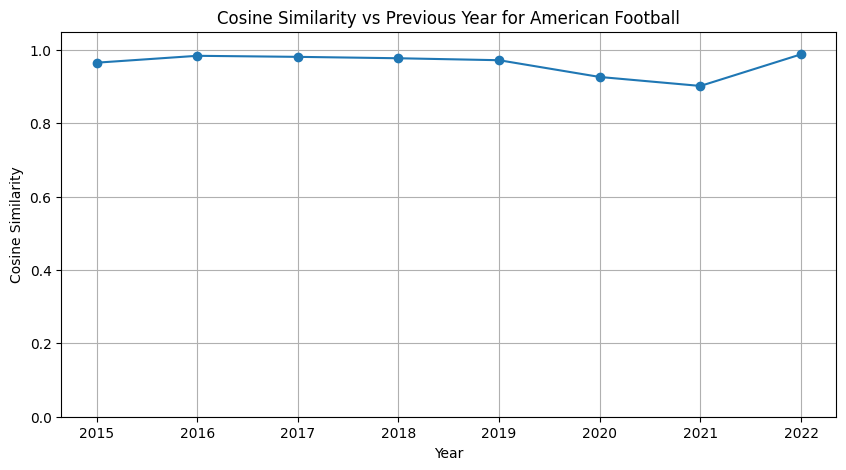

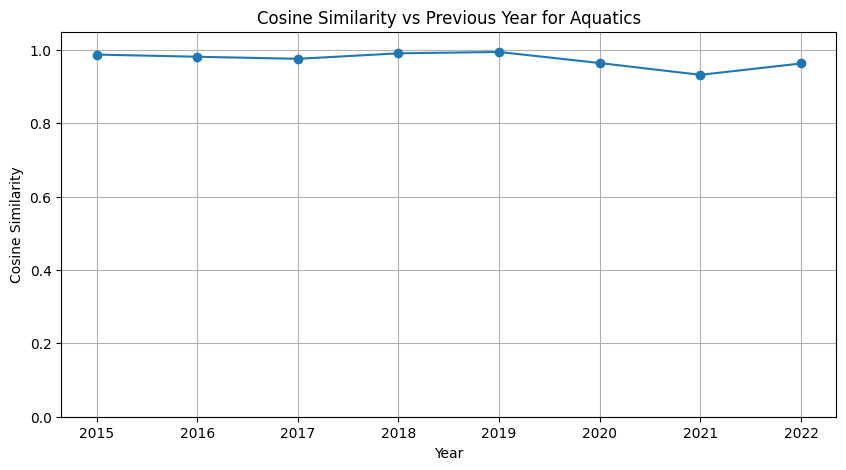

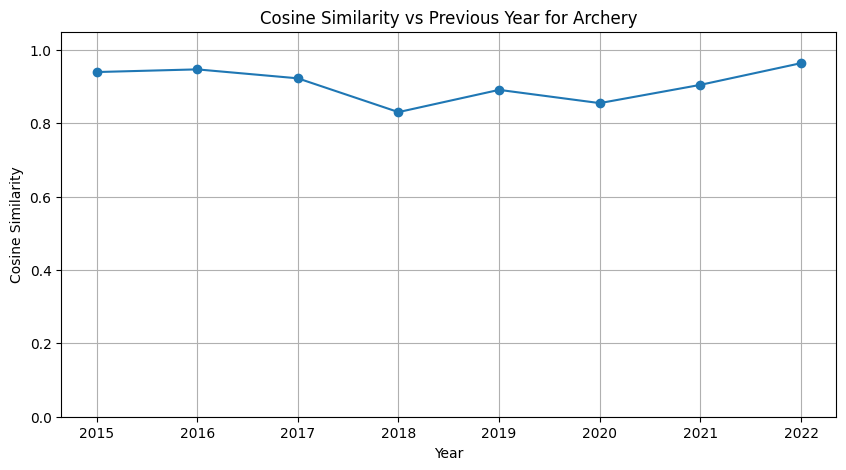

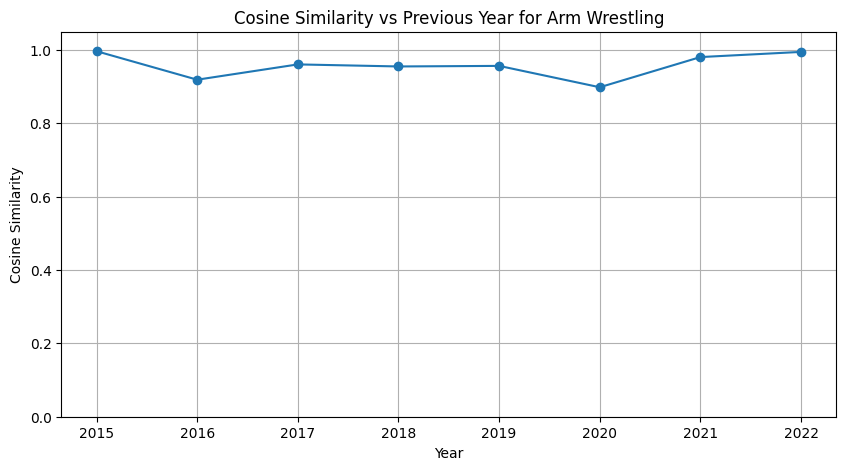

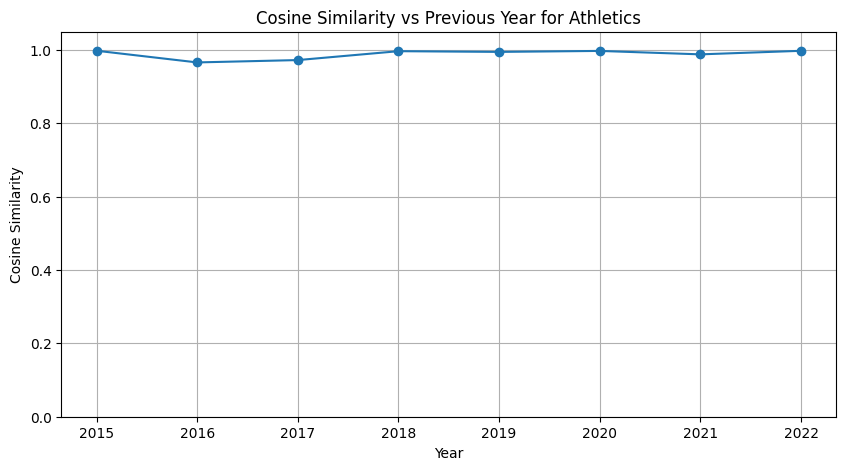

...

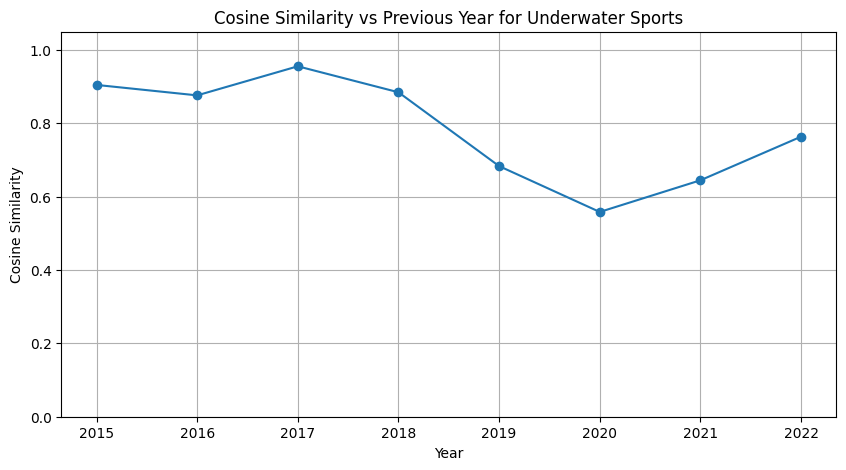

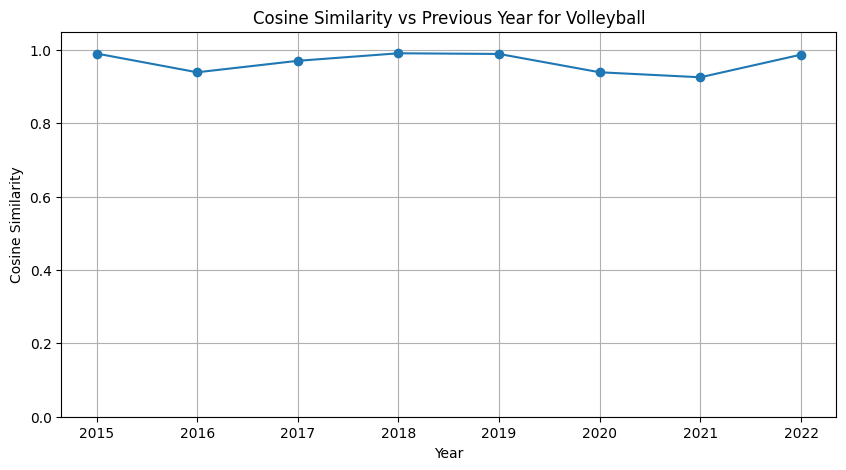

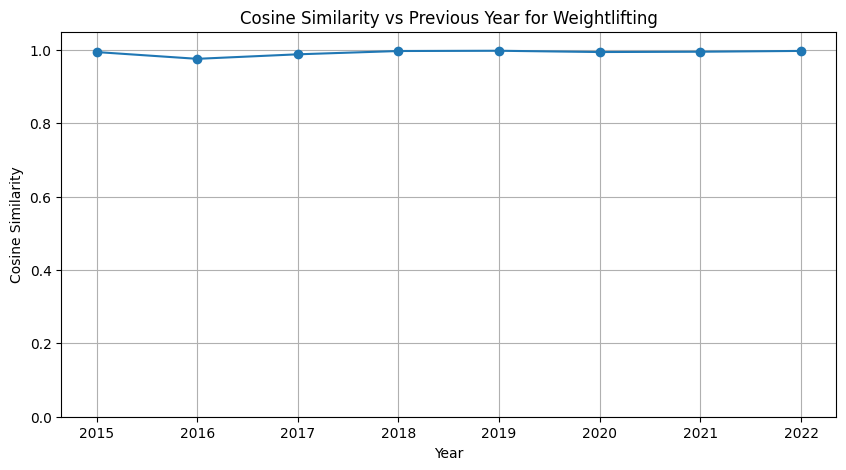

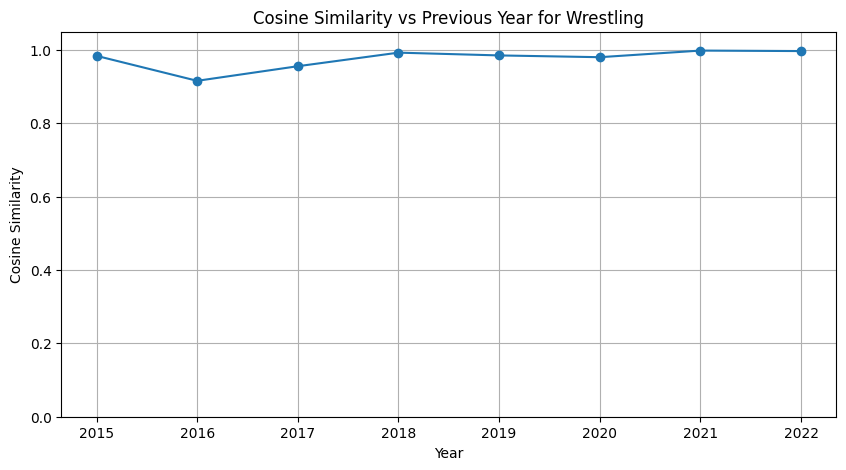

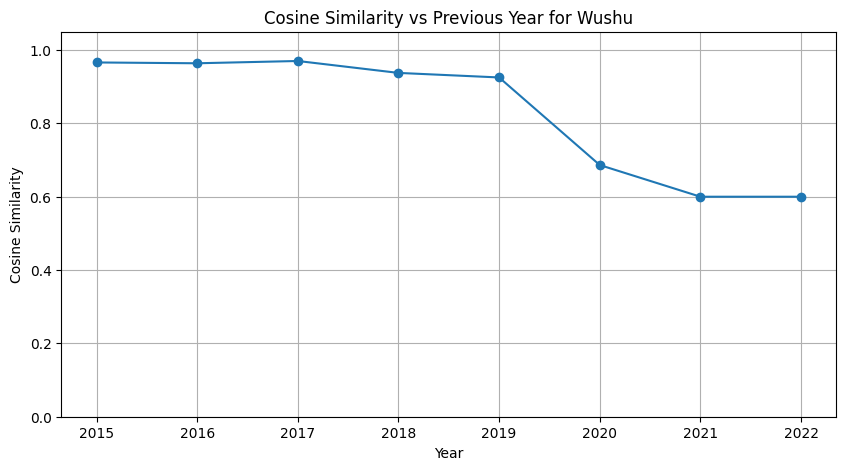

Average similarity transitions involving 2020:
Sport
American Football    0.914352
Aquatics             0.948490
Archery              0.880190
Arm Wrestling        0.939717
Athletics            0.992952
Badminton            0.808023
Basketball           0.986253
Biathlon             0.956139
Bodybuilding         0.999518
Boules Sports        0.872872
Boxing               0.981165
Cricket              0.851219
Cycling              0.996472
Equestrian           0.841171
Fencing              0.908177
Field Hockey         0.927304
Floorball            0.866025
Football             0.990329
Goalball             1.000000
Golf                 0.924332
Gymnastics           0.950394
Handball             0.953969
Ice Hockey           0.960392
Judo                 0.944003
Kabaddi              0.983867
Karate               0.899162
Kickboxing           0.962055
Muaythai             0.724113
Powerboating         0.538675
Powerlifting         0.990206
Roller Sports        0.687121
Rowing           

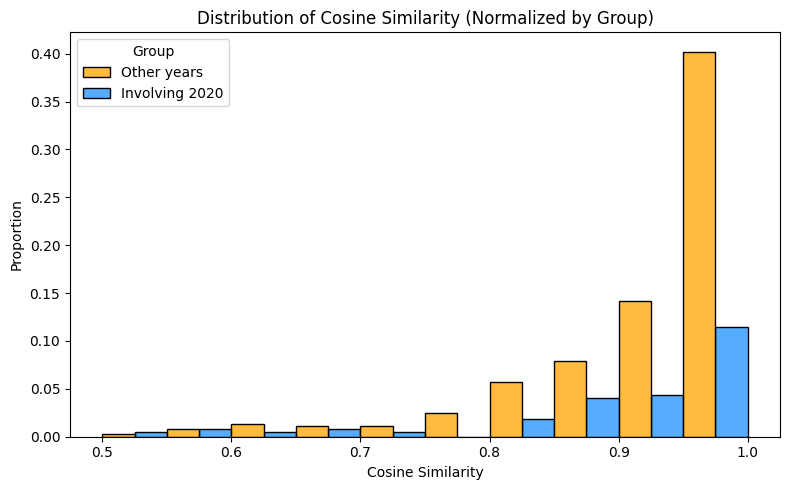

In [26]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial.distance import cosine
import seaborn as sns

summary = []
for chosen_sport in sorted(common_sports):
    df_sport = df_long[df_long['Sport'] == chosen_sport]
    if df_sport.empty:
        continue
    pivot = df_sport.pivot_table(index='Year', columns='Substance', values='Count', fill_value=0)
    pivot_norm = pivot.div(pivot.sum(axis=1), axis=0)
    years = list(pivot_norm.index)
    similarities = []
    for i in range(1, len(years)):
        y_prev, y_curr = years[i-1], years[i]
        v_prev = pivot_norm.loc[y_prev].reindex(pivot_norm.columns, fill_value=0).values
        v_curr = pivot_norm.loc[y_curr].reindex(pivot_norm.columns, fill_value=0).values
        sim = 1 - cosine(v_prev, v_curr)
        similarities.append(sim)
        # Track if transition involves 2020
        summary.append({
            'Sport': chosen_sport,
            'Year1': y_prev,
            'Year2': y_curr,
            'Cosine Similarity': sim,
            'Involves2020': (y_prev == 2020 or y_curr == 2020)
        })
    # Plot for each sport (optional)
    plt.figure(figsize=(10, 5))
    plt.plot(years[1:], similarities, marker='o')
    plt.title(f"Cosine Similarity vs Previous Year for {chosen_sport}")
    plt.xlabel("Year")
    plt.ylabel("Cosine Similarity")
    plt.ylim(0, 1.05)
    plt.grid(True)
    plt.show()

# Analyze across all sports
df_summary = pd.DataFrame(summary)
print("Average similarity transitions involving 2020:")
print(df_summary[df_summary['Involves2020']].groupby('Sport')['Cosine Similarity'].mean())

print("\nAverage similarity transitions NOT involving 2020:")
print(df_summary[~df_summary['Involves2020']].groupby('Sport')['Cosine Similarity'].mean())

# Or compare histograms:
# Ensure Group column exists (this is the key for the histogram hue)
df_summary['Group'] = df_summary['Involves2020'].map(
    {True: 'Involving 2020', False: 'Other years'}
)

plt.figure(figsize=(8, 5))
sns.histplot(
    data=df_summary,
    x='Cosine Similarity',
    hue='Group',
    multiple='dodge',
    bins=10,
    palette={'Involving 2020': 'dodgerblue', 'Other years': 'orange'},
    edgecolor='black',
    stat='probability'  # This normalizes within each group!
)
plt.xlabel('Cosine Similarity')
plt.ylabel('Proportion')
plt.title('Distribution of Cosine Similarity (Normalized by Group)')
plt.tight_layout()
plt.show()


While the vast majority of year-to-year transitions outside of 2020 were nearly identical in substance profiles, only about 10% of transitions involving 2020 were similarly stable, indicating that the pandemic year was associated with a marked increase in atypical changes in anti-doping test substance distributions.